## Configuración inicial

A continuación se importan las librerías necesarias para el funcionamiento del notebook.

In [1]:
#plots and data
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

#metrics and transformations
from sklearn.preprocessing import MinMaxScaler,StandardScaler
from sklearn.metrics import mean_squared_error
from sklearn import metrics

#Model 
from sklearn.neural_network import MLPRegressor
sns.set()

In [3]:
def plot_predict_test(df_test_y,testPredict,lag):
        ### Resultado predicción datos de entrenamiento
    print(testPredict.flatten())
    fig, ax = plt.subplots(figsize=[15,8])
    sns.lineplot(df_test_y.flatten(),label="real")
    sns.lineplot(testPredict.flatten(),label="predicción")
    plt.title("Comparación valor real y predicción")
    plt.ylabel("value")

In [4]:
def createLagFeature(name_features,lag,df):
    for name_feature in name_features:
        for i in range(1,lag+1):
            df[name_feature+"lag"+str(i)]=df[name_feature].shift(i)
    return df

In [5]:
#function to measure the performance
def timeseries_evaluation_metrics_func(y_true, y_pred,flag):
    def mean_absolute_percentage_error(y_true, y_pred): 
        epsilon=0.1e-5
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    
    if flag : print(f'R2 is : {metrics.r2_score(y_true, y_pred)}',end='\n\n')
    else:
        print('Evaluation metric results:')
        print(f'MSE is : {metrics.mean_squared_error(y_true, y_pred)}')
        print(f'MAE is : {metrics.mean_absolute_error(y_true, y_pred)}')
        print(f'RMSE is : {np.sqrt(metrics.mean_squared_error(y_true, y_pred))}')
        print(f'MAPE is : {mean_absolute_percentage_error(y_true, y_pred)}')
        
    return {"MSE":metrics.mean_squared_error(y_true, y_pred),
           "MAE":metrics.mean_absolute_error(y_true, y_pred),
           "RMSE":np.sqrt(metrics.mean_squared_error(y_true, y_pred)),
           "MAPE":mean_absolute_percentage_error(y_true, y_pred)}

---

## Cargar y preparar los datos.

In [3]:
df = pd.read_csv("../../Datasets/Datos_durante_pandemia/data_durante_vol_ve_in.csv")

df['Fecha'] = pd.to_datetime(df['Fecha'])
df = df.sort_values('Fecha', ascending=True)
df = df.rename(columns = {'Vol. Futuros': 'VolFuturos'})
df

,Fecha,VolFuturos,TRM,Precio Interno,VIX,EMV-ID,EPU
0,2020-01-01,1.289946,3277.14,975000.0,12.548403,1.89,186.06
1,2020-01-02,0.735046,3277.14,945000.0,12.470000,2.84,139.13
2,2020-01-03,0.591834,3258.84,940000.0,14.020000,1.33,108.10
3,2020-01-04,1.367154,3262.05,930000.0,14.646666,0.00,212.82
4,2020-01-05,1.505321,3262.05,920000.0,14.311970,0.86,173.76
...,...,...,...,...,...,...,...
913,2022-07-02,0.778572,4198.77,2270000.0,25.922916,11.11,130.95
914,2022-07-03,0.819483,4198.77,2270000.0,26.641413,23.06,135.95
915,2022-07-04,0.843804,4198.77,2270000.0,27.530000,15.98,309.83
916,2022-07-05,0.850985,4198.77,2280000.0,27.540000,18.90,116.59


---

## Desarrollo del modelo

In [7]:
#objects to scale the data 
sc=StandardScaler()
sc2=StandardScaler()

In [8]:
df_stats=df

In [9]:
#
len_data=df_stats.shape[0]

#get target
df_label=df_stats["VolFuturos"].values.reshape(len_data,1)
#get attributes
df_data=df_stats.drop(columns=["Fecha"])

#apply scale
#df_label=sc.fit_transform(df_label)
#df_data_normalize=sc2.fit_transform(df_data)


In [10]:
def Model(df_data,df_label,lag,estimators):
    delete_columns=list(df_data.columns)
    df_data_lags=createLagFeature(df_data.columns,lag,df_data) if lag>0 else df_data
    
    df_data_lags.drop(columns=delete_columns,inplace=True)
    df_data_lags=df_data_lags[lag:]
    df_label=df_label[lag:]

    #transform data
    df_data_lags=sc2.fit_transform(df_data_lags)
    
    #split data
    #last index of the train data
    seventy_percent=int(len_data*0.7)

    #split the data normalize
    
    df_train=df_data_lags[:seventy_percent]
    df_test=df_data_lags[seventy_percent:]

    #split labels
    
    df_train_y=df_label[:seventy_percent]
    df_test_y=df_label[seventy_percent:]
    #split labels normalize
    
    df_label_normalize=sc.fit_transform(df_label)
    df_train_y_normalize=df_label_normalize[:seventy_percent]
    df_test_y_normalize=df_label_normalize[seventy_percent:]
    


    #make model
    model=MLPRegressor(hidden_layer_sizes=(estimators,), activation='logistic', solver='adam')
    #fit the model with the train data
    history=model.fit(df_train,df_train_y_normalize)
   
    # make predictions
    trainPredict = model.predict(df_train)
    trainPredict = np.reshape(trainPredict,(len(trainPredict),1))
    # invert transformation
    trainPredict = sc.inverse_transform(trainPredict)
    
    trainY = df_train_y
    
    # make predictions
    testPredict = model.predict(df_test)
    # invert transformation
    testPredict = np.reshape(testPredict,(len(testPredict),1))
    testPredict = sc.inverse_transform(testPredict)
    testY = df_test_y
    print("len test: ",testY.shape)
    print("len PREDICT: ",testPredict.shape)

    plot_predict_test(df_train_y,trainPredict,lag)
    plot_predict_test(df_test_y,testPredict,lag)
    return [{"Fecha":df_stats.Fecha[lag:][:seventy_percent],"typeELM":["train"]*len(trainPredict.flatten()),"ELM" :trainPredict.flatten()}
            ,{"Fecha":df_stats.Fecha[lag:][seventy_percent:],"typeELM":["test"]*len(testPredict.flatten()),"ELM":testPredict.flatten()}]
    
    return {"train":timeseries_evaluation_metrics_func(trainY.flatten()+1, trainPredict.flatten()+1,False),
           "test":timeseries_evaluation_metrics_func(testY.flatten()+1, testPredict.flatten()+1,False)}

## Resultados

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.99624828 1.11893411 1.09306177 0.9418705  0.93597944 1.44473308
 0.98964057 1.32263033 0.95914122 1.35729919 1.0245444  0.99027404
 1.01954188 1.04741467 0.9340105  0.95395349 0.88180091 0.85123921
 0.87393689 0.78616282 1.17623106 1.24944698 1.35298436 1.20320067
 1.18557745 1.2672465  1.57305775 1.03247782 1.46962107 1.07542391
 1.54381982 1.2628797  1.13558934 1.09753816 0.90569897 0.89465489
 0.95391473 1.00341853 0.99788618 0.89925269 0.96670198 1.81598616
 1.84980892 1.38599478 1.60071291 1.38624284 1.03727863 1.02910858
 1.64485733 2.03097756 1.41245485 2.00608552 1.49219043 1.33873561
 1.55092954 1.04961691 1.48931867 1.07000215 1.30882337 2.01960302
 2.37131428 1.95963522 2.91087653 2.03065732 1.97279757 1.30251681
 1.799462   2.01785613 1.99041599 2.24701575 1.78926627 1.53361287
 1.33750991 1.51443212 1.99406743 2.92327329 2.86891225 2.19423978
 1.96346706 1.51305799 1.2754984  2.07031885 2.17499964 2.72554287
 3.09895729 2.07474

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.11483589 1.24553004 1.22944693 1.06960293 1.05384435 1.57227592
 1.13235668 1.44234668 1.08977839 1.48752891 1.16186132 1.11141493
 1.14181191 1.1752814  1.06511006 1.07129405 0.99098263 0.95783002
 0.98654165 0.89539459 1.29680787 1.37485139 1.45342104 1.31392206
 1.28469968 1.37304657 1.6693774  1.12822265 1.55971913 1.18726901
 1.62471095 1.3518126  1.22131026 1.17846529 0.99640769 0.98882473
 1.0737015  1.1110081  1.1003799  1.00142164 1.04168752 1.87528004
 1.87702406 1.46203651 1.67556041 1.47454843 1.12851589 1.15711954
 1.71568782 2.05189583 1.49284103 2.02498734 1.56246948 1.4233736
 1.62911616 1.15719119 1.57427453 1.16759353 1.35408549 2.02177334
 2.31104814 1.93288473 2.79393278 2.01396945 1.97751082 1.37643119
 1.82886933 2.01665429 2.01684927 2.16432488 1.77822299 1.54751472
 1.30695953 1.46903242 1.89472102 2.76864085 2.80761505 2.04125635
 1.89210607 1.40831639 1.26356963 1.9207254  2.0710319  2.57931156
 2.98177576 1.888101

Evaluation metric results:
MSE is : 1.4851357934317766
MAE is : 0.8802106672336298
RMSE is : 1.2186614761416628
MAPE is : 42.472807146112146
Evaluation metric results:
MSE is : 1.3222309240778776
MAE is : 0.9165304072400826
RMSE is : 1.149883004517363
MAPE is : 48.26682440275123


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.02609117 1.16855694 1.1598552  0.97462319 0.95345659 1.53978834
 1.05891085 1.38017693 0.99361562 1.44478695 1.08962591 1.02065784
 1.06015765 1.09986089 0.98562887 0.98963734 0.90190108 0.86593711
 0.89917097 0.79816712 1.24829292 1.32797111 1.4368447  1.26011256
 1.22528081 1.33450216 1.68364036 1.07072174 1.53149921 1.13731836
 1.62620554 1.33056602 1.16541759 1.11250077 0.91213736 0.90414968
 1.00925778 1.06385199 1.03766036 0.92311178 0.99500231 1.89135429
 1.92560641 1.43437307 1.64102955 1.45181989 1.07093069 1.06464901
 1.74003559 2.14375412 1.48136381 2.05319952 1.55886407 1.38835743
 1.61753304 1.10169285 1.56419074 1.14005956 1.34983825 2.07302501
 2.46783324 2.00184538 3.05608252 2.11611658 2.0471444  1.36789388
 1.86308798 2.11639538 2.13491104 2.24823983 1.87509543 1.62879596
 1.29496251 1.52923941 1.97950182 3.03288213 3.04259692 2.1593672
 1.95153003 1.43688826 1.23816539 2.01744965 2.15277008 2.7526863
 3.28722367 1.9518659

Evaluation metric results:
MSE is : 1.4769872208000936
MAE is : 0.8786335375097523
RMSE is : 1.215313630632066
MAPE is : 42.0829572066739
Evaluation metric results:
MSE is : 1.3465376772796198
MAE is : 0.9235834234296244
RMSE is : 1.1604041008543617
MAPE is : 48.52251269073802


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.01729015 1.14840206 1.13830278 0.96930397 0.94935185 1.4980992
 1.0413132  1.3598391  0.98762234 1.41012055 1.07088391 1.0155726
 1.04746034 1.07764201 0.96871653 0.97794411 0.89112118 0.85431121
 0.88292303 0.78612168 1.21865689 1.29455755 1.39402435 1.24466042
 1.21135535 1.30453059 1.63092816 1.06097337 1.50001419 1.11747322
 1.57832291 1.30356297 1.15412717 1.10469148 0.91042218 0.90280123
 0.9934761  1.03663157 1.01914595 0.91542775 0.97707322 1.84078741
 1.85757596 1.41054589 1.60705661 1.4220275  1.06598629 1.06129212
 1.66999631 2.06840617 1.46241624 1.9941484  1.52346352 1.3639729
 1.5706279  1.07979658 1.507734   1.1241522  1.33425619 1.9972173
 2.36500532 1.94771757 2.94521971 2.03364396 1.96773482 1.31544511
 1.80348083 2.07032396 2.09391509 2.17401485 1.81439435 1.60368551
 1.31178474 1.54481081 1.97940085 2.96999363 2.9638267  2.17367544
 2.01543271 1.44921215 1.25326806 2.01238255 2.17999425 2.75248327
 3.24588779 2.00525307 

Evaluation metric results:
MSE is : 1.3462495597199682
MAE is : 0.9245216034504662
RMSE is : 1.1602799488571576
MAPE is : 48.73480129971542


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.14788329 1.2862341  1.27543682 1.09614809 1.07706729 1.63711341
 1.18355981 1.46930774 1.11152738 1.53659303 1.2112376  1.1384008
 1.17902898 1.22471884 1.10895697 1.11150939 1.03344726 1.0028669
 1.03345256 0.9327819  1.36300388 1.44201457 1.52571828 1.36197068
 1.33667818 1.44749176 1.77843107 1.19145456 1.6138219  1.25676099
 1.72027436 1.43845124 1.28163979 1.24423842 1.05789428 1.03941033
 1.12830367 1.17516035 1.16191088 1.04195199 1.10985081 1.99910183
 2.02020439 1.49902957 1.69555909 1.54353746 1.18844254 1.17649088
 1.8221116  2.2286503  1.55400399 2.07369601 1.64541731 1.4721783
 1.68796555 1.20014992 1.61650499 1.22385128 1.41644044 2.15634668
 2.53777664 2.06584491 3.09718108 2.14709264 2.02888334 1.4062751
 1.9318665  2.14667308 2.12764681 2.27547031 1.89820925 1.65745856
 1.37943238 1.57207848 2.00989074 3.0935651  3.07799776 2.17743518
 2.02301471 1.4636133  1.36043667 2.06604764 2.20349752 2.81144311
 3.37919853 2.05916443 

Evaluation metric results:
MSE is : 1.483164767894144
MAE is : 0.8972111786590432
RMSE is : 1.2178525230479034
MAPE is : 44.402394652221496
Evaluation metric results:
MSE is : 1.3655365554792998
MAE is : 0.9371867514424742
RMSE is : 1.1685617465411486
MAPE is : 49.940280786815364


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.02143114 1.16396729 1.15444777 0.97048299 0.95036213 1.52796082
 1.05200926 1.36409606 0.98979273 1.43196821 1.08448706 1.0150055
 1.05642525 1.09788562 0.98274304 0.98541507 0.89880026 0.86428363
 0.89615994 0.79644251 1.24260547 1.31582636 1.41562902 1.24081847
 1.20901428 1.32088728 1.65385043 1.05851072 1.50323907 1.12657782
 1.59878203 1.30799281 1.14871128 1.10450225 0.9142708  0.90359278
 1.00255092 1.05280931 1.03012131 0.91715321 0.99246729 1.86185848
 1.87904672 1.39163097 1.6037645  1.42986565 1.06245961 1.0404943
 1.71807189 2.08732327 1.43970978 1.99605958 1.53122658 1.35761479
 1.58349104 1.08379857 1.51516237 1.11412325 1.30335233 2.01228105
 2.3842102  1.93234095 2.97871023 2.0310452  1.97299803 1.30603254
 1.81393982 2.06980345 2.04584223 2.16800372 1.81601106 1.55617418
 1.24885943 1.46630788 1.86659187 2.95827388 2.98228012 2.13663963
 1.91475528 1.36310516 1.2274621  1.96838581 2.11112277 2.7126202
 3.26629574 1.93099933

Evaluation metric results:
MSE is : 1.481054273161208
MAE is : 0.8744645420900716
RMSE is : 1.2169857325216298
MAPE is : 41.531074074063746
Evaluation metric results:
MSE is : 1.331886781677826
MAE is : 0.9138008218192538
RMSE is : 1.1540739931554762
MAPE is : 47.47459654370001


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.08909406 1.22885692 1.21378012 1.0411914  1.02426161 1.57347801
 1.11627225 1.42479876 1.06271815 1.48046926 1.14826696 1.08681372
 1.12371746 1.16392102 1.04704995 1.05355452 0.97169972 0.93837186
 0.96830407 0.86903904 1.29930908 1.37243745 1.45813426 1.29946551
 1.27712359 1.37845056 1.6936284  1.12788273 1.55939268 1.18847898
 1.65108813 1.37224011 1.22594363 1.18763417 1.00100782 0.99244303
 1.07558321 1.12142403 1.11534027 0.99631582 1.06434833 1.91985422
 1.9448313  1.45319984 1.65138868 1.48477663 1.13369122 1.11484331
 1.75247696 2.1436855  1.49994848 2.02978993 1.58587083 1.42266462
 1.63675606 1.1436426  1.55057453 1.17429802 1.37850875 2.09410011
 2.4584249  1.98862776 3.02087987 2.0580115  1.97957766 1.34296353
 1.8652331  2.12359554 2.04299292 2.21922908 1.82753672 1.55695235
 1.34514191 1.5354359  2.05037445 3.09953197 3.08134378 2.18428654
 2.00184715 1.46879295 1.33243435 2.04660908 2.19755327 2.76822721
 3.32061909 2.00386

Evaluation metric results:
MSE is : 1.4818995984010637
MAE is : 0.8892049739148596
RMSE is : 1.2173329858346333
MAPE is : 43.44467922389083
Evaluation metric results:
MSE is : 1.3406721153185155
MAE is : 0.9198814029626645
RMSE is : 1.1578739634858863
MAPE is : 48.33993248735437


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.04372673 1.18101601 1.17482145 1.00011128 0.9692776  1.52757031
 1.08788148 1.38958549 1.01532899 1.4339251  1.11037435 1.04402132
 1.06219845 1.10751563 0.99849961 0.99959457 0.9096416  0.87290487
 0.90351954 0.81121562 1.2369576  1.33815009 1.4400078  1.27450273
 1.23372499 1.34069392 1.66942221 1.10536355 1.52205359 1.14550517
 1.61150451 1.33802995 1.1810207  1.11984012 0.9253362  0.91339342
 1.00370308 1.05186876 1.04703937 0.93664284 0.98701682 1.86746589
 1.9233333  1.45603331 1.64185826 1.44144363 1.09582308 1.08322404
 1.71978174 2.12775272 1.50212525 2.03253021 1.55806616 1.40175128
 1.60587553 1.12500634 1.55188493 1.15165462 1.32509411 2.05004997
 2.43791013 2.01285846 3.08057965 2.10940817 2.0323179  1.3604299
 1.87295209 2.1053776  2.04665261 2.25422677 1.8994706  1.59930675
 1.35908736 1.51564326 1.94712129 3.01816943 3.12284315 2.24468905
 2.03943862 1.43296405 1.32041468 2.00919458 2.17265949 2.79469508
 3.39259614 2.089587

Evaluation metric results:
MSE is : 1.4832542492853826
MAE is : 0.8882425550756993
RMSE is : 1.2178892598612496
MAPE is : 43.172280276481516
Evaluation metric results:
MSE is : 1.399942573319584
MAE is : 0.9593424194796877
RMSE is : 1.1831916891694194
MAPE is : 51.821651090755694


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.04455202 1.1808082  1.16479335 0.99437545 0.97566148 1.53223608
 1.05897213 1.3986361  1.01443463 1.44270922 1.09341216 1.04391339
 1.07173747 1.10399203 0.9883185  1.0002074  0.90968524 0.87068455
 0.89997336 0.80253958 1.23939777 1.32137838 1.42984567 1.26626804
 1.23619516 1.33139482 1.65154219 1.0796828  1.53506391 1.13318616
 1.60693279 1.32318951 1.17839276 1.13028721 0.92397257 0.91332204
 1.00474758 1.05347201 1.0405901  0.9352933  0.99441361 1.86747371
 1.88680959 1.44202249 1.65486442 1.44681951 1.0827779  1.07891107
 1.71733165 2.09160512 1.47195826 2.05101432 1.54904764 1.39306648
 1.60752086 1.11568435 1.54791383 1.13211198 1.35253786 2.02264714
 2.39837028 1.9704321  3.08251482 2.05825987 2.02225697 1.35510981
 1.85169966 2.06833189 2.04118128 2.23499504 1.84580968 1.5648807
 1.33712151 1.52311548 1.92594978 2.97452482 3.03453328 2.19900165
 2.01810226 1.47417445 1.23544966 1.99255858 2.13825292 2.76526897
 3.34557262 2.014301

Evaluation metric results:
MSE is : 1.4818576497551346
MAE is : 0.8822885341028456
RMSE is : 1.2173157559791685
MAPE is : 42.54308170412175
Evaluation metric results:
MSE is : 1.3701876561395385
MAE is : 0.9381496055338419
RMSE is : 1.1705501510569885
MAPE is : 49.86573171600474


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.97113444 1.10166896 1.08681038 0.91987592 0.90466343 1.44170059
 0.98640937 1.30114487 0.93980524 1.35686388 1.02241218 0.96893573
 1.00725719 1.03957945 0.930052   0.94232489 0.86044074 0.82581713
 0.85393382 0.75671588 1.18648675 1.25141428 1.34911108 1.19696189
 1.17735778 1.26905275 1.58057391 1.02611903 1.45853842 1.08800711
 1.54400194 1.27326105 1.1290609  1.08491729 0.89246253 0.88533616
 0.97632683 1.02493566 1.00860798 0.90142175 0.97999815 1.803179
 1.80831157 1.34383234 1.54753415 1.38491214 1.03162165 1.01854653
 1.64356324 2.00653688 1.38977898 1.93773322 1.47850507 1.31893113
 1.5350633  1.0525598  1.46424939 1.11612725 1.33817673 1.98338457
 2.33293149 1.87165185 2.96938957 1.95524293 1.9159988  1.26192383
 1.75067276 2.03585432 2.05275515 2.17804705 1.79161341 1.5790721
 1.34906364 1.58837624 2.11166103 3.13908955 3.06416085 2.23815727
 2.04583374 1.52301728 1.27748024 2.05907593 2.23209762 2.80707265
 3.3775591  2.00022079

Evaluation metric results:
MSE is : 1.4834492001843949
MAE is : 0.8822328259764844
RMSE is : 1.2179692936131004
MAPE is : 42.37704975640623
Evaluation metric results:
MSE is : 1.3345149814232986
MAE is : 0.9143682016933277
RMSE is : 1.1552120936967802
MAPE is : 47.657996791499045


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.10332279 1.24514109 1.24780424 1.06713324 1.02645537 1.58864366
 1.1735828  1.44222888 1.08168077 1.4915954  1.18958983 1.1027543
 1.12082483 1.17644105 1.07228535 1.06197348 0.97129498 0.93706832
 0.96577005 0.87473384 1.29504832 1.42197255 1.5056816  1.34003999
 1.28798389 1.39967347 1.74104246 1.17541407 1.55138188 1.20933168
 1.65581755 1.40105347 1.21835388 1.15876195 0.97365403 0.95947014
 1.04873631 1.09688889 1.08013025 0.98980523 1.01618918 1.9151289
 1.99663808 1.48928926 1.65770177 1.4972558  1.14007391 1.13637315
 1.74885549 2.18644973 1.55133212 2.03770774 1.59785048 1.44038379
 1.64176484 1.17116967 1.57461033 1.18661832 1.32094593 2.04837266
 2.46448215 2.00813277 3.08205506 2.14278644 1.9856517  1.25249803
 1.74086103 2.06901335 2.04451565 2.16171804 1.79137503 1.48819194
 1.14978112 1.32972567 1.80352983 2.80685148 3.06214574 2.10021191
 1.8147969  1.16942356 1.05669732 1.8650627  2.04788271 2.65155023
 3.34573533 1.9984284

<ipython-input-3-72e029a2b199>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=[15,8])


Evaluation metric results:
MSE is : 1.4904413633036624
MAE is : 0.8771613824044348
RMSE is : 1.2208363376405793
MAPE is : 41.44489283112718
Evaluation metric results:
MSE is : 1.3448821530382753
MAE is : 0.9289017095726326
RMSE is : 1.1596905419284385
MAPE is : 49.14131444025044


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[0.90739733 1.06844831 1.07296036 0.86434376 0.81708712 1.44353975
 1.00010313 1.25298627 0.87510298 1.32507855 1.01256546 0.89412685
 0.92309054 1.00020422 0.88398891 0.86453728 0.77611711 0.74466281
 0.78480131 0.68256219 1.1413956  1.28016481 1.3600343  1.15922532
 1.11143978 1.24958901 1.62700669 1.00806931 1.39442418 1.05906095
 1.54051252 1.26602488 1.05335834 0.9989444  0.81929941 0.79300975
 0.89125002 0.9509589  0.94742572 0.82355036 0.8738322  1.83999817
 1.93929558 1.34293581 1.48844634 1.36735189 0.9837622  0.95270677
 1.66419019 2.15119498 1.41599833 1.89703182 1.4765754  1.28111933
 1.50685266 1.03490125 1.44506828 1.06067834 1.21000992 2.01361548
 2.49910977 1.96519679 3.10901378 2.08666386 1.89171564 1.22589578
 1.81612954 2.14545861 2.04180928 2.18334376 1.85634759 1.55426138
 1.30702762 1.4562594  1.89428766 3.13355655 3.35220668 2.30122618
 1.92065864 1.35043996 1.29465377 2.08249032 2.2768734  2.87808696
 3.63906412 2.13432

Evaluation metric results:
MSE is : 1.487798715430517
MAE is : 0.8828537469334192
RMSE is : 1.2197535470046879
MAPE is : 42.219384464220596
Evaluation metric results:
MSE is : 1.3919011805010757
MAE is : 0.9528614196882826
RMSE is : 1.1797886168721394
MAPE is : 50.94782701846772


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (273, 1)
len PREDICT:  (273, 1)
[1.20446389 1.33357362 1.31130582 1.15158841 1.14433546 1.67779598
 1.19539857 1.55801939 1.17461582 1.59729928 1.23648882 1.20557366
 1.23940498 1.25675102 1.13849832 1.15799788 1.06865427 1.02883545
 1.05448143 0.95448258 1.38644578 1.44335608 1.54770949 1.40029519
 1.37771077 1.46120013 1.76231132 1.20274604 1.66969856 1.25458277
 1.71712844 1.42530188 1.31455067 1.2794903  1.07260992 1.05920256
 1.14621584 1.17977461 1.17361715 1.07057532 1.13471743 1.97201349
 1.95604274 1.53441358 1.79500314 1.55990297 1.20395478 1.21090555
 1.82927976 2.16070068 1.55623105 2.17183658 1.6454541  1.49311371
 1.7144122  1.21300832 1.61866458 1.2013235  1.39748904 2.06763003
 2.41223872 2.00348767 3.20750755 2.09560993 2.09828935 1.41041537
 1.88494391 2.06884022 2.04033168 2.2147478  1.78133202 1.48644567
 1.24766502 1.41017395 1.79111598 2.9276663  2.97349113 2.08939533
 1.98254164 1.32221297 1.16896317 1.88760123 2.01332819 2.65553045
 3.33067751 1.90799

Evaluation metric results:
MSE is : 1.4862087407158482
MAE is : 0.885716829379174
RMSE is : 1.2191016121373346
MAPE is : 43.053300205630656
Evaluation metric results:
MSE is : 1.32113704724363
MAE is : 0.9064238101733075
RMSE is : 1.1494072590877569
MAPE is : 46.60098704609293


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.21160389 1.04034482 1.03401543 1.60289182 1.12139392 1.43646234
 1.08434958 1.52479963 1.1721229  1.09936274 1.15116977 1.18635954
 1.06387484 1.07151424 1.00130362 0.96690113 0.99133594 0.88954133
 1.32713342 1.39568118 1.50070032 1.3942805  1.38637417 1.47656985
 1.77860557 1.15137324 1.61624979 1.25475286 1.68046862 1.43086447
 1.28541412 1.25631002 1.08966932 1.01186554 1.07784932 1.12214856
 1.10712359 1.0736464  1.12909668 1.99053775 1.97380444 1.45380979
 1.81680117 1.60124838 1.21438373 1.17104519 1.80062871 2.20491147
 1.56074787 2.03215273 1.61157902 1.42525733 1.66101676 1.23106929
 1.71307546 1.34068625 1.65810915 2.21988002 2.50038942 2.24932963
 2.9659757  2.13358413 1.98021237 1.56884009 2.07028793 2.20027386
 2.07767966 2.03575055 1.90616762 1.907911   1.42514709 1.78983947
 2.17669667 3.03279827 2.99176366 2.24487099 2.02194819 1.691935
 1.41231697 2.28129779 2.47685561 2.77928184 3.05634941 1.96989284
 2.45463036 2.0885579

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.12039307 0.95951952 0.94049021 1.48152211 1.04511365 1.3297557
 0.98194408 1.42533474 1.08982012 1.01726896 1.04643352 1.10651198
 0.99395385 0.99450117 0.92499865 0.89836566 0.9223883  0.82964577
 1.23757084 1.31982405 1.40600877 1.28881257 1.27961165 1.38417407
 1.70399836 1.07411765 1.49600014 1.16711314 1.62928366 1.34617091
 1.18705079 1.14607258 0.98831243 0.93825532 1.01138279 1.05100102
 1.04408806 1.01462201 1.03944434 1.90816803 1.90718078 1.41775994
 1.68555351 1.51127395 1.12309033 1.12006896 1.68647742 2.1922152
 1.52407282 1.91390762 1.52160855 1.40690364 1.6041585  1.19379409
 1.6567732  1.28900474 1.64072723 2.19766246 2.57859427 2.2264718
 3.09380877 2.13700674 2.00157678 1.52079256 2.1708887  2.38803294
 2.10210278 2.06706355 2.01293519 1.99436699 1.49035673 1.80783866
 2.32686095 3.29530771 3.37183358 2.13823201 1.95996075 1.71347976
 1.44418912 2.5105732  2.61146099 2.98653926 3.41834554 2.01950276
 2.47222905 2.19527406

Evaluation metric results:
MSE is : 1.413935524463217
MAE is : 0.8637486677108573
RMSE is : 1.1890902087155613
MAPE is : 41.522537683905384
Evaluation metric results:
MSE is : 1.391696709882329
MAE is : 0.9449880072803752
RMSE is : 1.1797019580734487
MAPE is : 50.33547568735052


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.16097368 1.00492626 1.01552873 1.52305534 1.06738124 1.35459572
 1.06770299 1.46922508 1.135507   1.08511642 1.13448883 1.17127912
 1.06186196 1.06948859 1.01874027 0.98751625 1.00217116 0.91353548
 1.30628798 1.36164118 1.46809142 1.37483867 1.38691634 1.47421744
 1.75873867 1.16050681 1.62175916 1.28871194 1.68744905 1.44434776
 1.31170103 1.2804195  1.10736877 1.04442203 1.11773204 1.1636801
 1.16201991 1.14865179 1.18226504 1.97409883 1.95268738 1.46824195
 1.7944985  1.61319718 1.19846024 1.2399173  1.76469449 2.19441967
 1.59066072 2.00172967 1.64343938 1.48047601 1.71707119 1.31537857
 1.78309011 1.42678002 1.76541751 2.38097826 2.6551764  2.29793164
 3.19446261 2.1124114  1.98780948 1.59573945 2.16799381 2.39447644
 2.14931327 2.05923945 2.07370156 1.93846208 1.34887783 1.88164304
 2.3982594  3.28298777 3.2009669  2.11285543 1.81802155 1.56406436
 1.34061342 2.43465013 2.42032218 2.86629353 3.12924707 1.85589479
 2.36831411 1.955100

Evaluation metric results:
MSE is : 1.3884764754218901
MAE is : 0.8532143296815201
RMSE is : 1.1783363167711882
MAPE is : 40.89299674950701
Evaluation metric results:
MSE is : 1.326827592095127
MAE is : 0.9032681087020511
RMSE is : 1.151880025043896
MAPE is : 46.081946868286394


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.24735305 1.07296692 1.07669927 1.63792696 1.1471837  1.47635883
 1.1209209  1.59572042 1.21322982 1.1583297  1.20041084 1.24180554
 1.11779499 1.11829831 1.04659339 1.01352096 1.02704746 0.91884799
 1.37015176 1.40989399 1.51815013 1.42825832 1.4351575  1.52908165
 1.81650521 1.15724783 1.68785005 1.30222738 1.75332532 1.45443809
 1.32275748 1.2879472  1.11870137 1.04974886 1.12461839 1.16549164
 1.15474528 1.13359963 1.18134653 2.02329213 1.96107592 1.45643482
 1.8922912  1.67799021 1.27496537 1.2411602  1.82314499 2.23585437
 1.58542192 2.11913656 1.70476613 1.55365936 1.77712844 1.30885571
 1.83034408 1.41692508 1.75265479 2.32130254 2.56010105 2.31419439
 3.21619225 2.19634347 2.1369427  1.708767   2.23540049 2.40596
 2.18661647 2.11076858 2.11701621 2.09153906 1.42527431 1.96035991
 2.37991278 3.35636137 3.30904146 2.31746409 1.9527781  1.75368441
 1.42366559 2.42557881 2.59739645 2.93306201 3.31459685 1.86107722
 2.54932058 2.15568571

Evaluation metric results:
MSE is : 1.4027750280104745
MAE is : 0.8647482733577524
RMSE is : 1.1843880394577084
MAPE is : 41.93294615703838
Evaluation metric results:
MSE is : 1.3711614642133367
MAE is : 0.9277461043304139
RMSE is : 1.170966038881289
MAPE is : 48.324674154701256


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.10796791 0.93526577 0.9269405  1.49231627 1.01580564 1.31049261
 0.9473663  1.44227067 1.07518264 1.01447438 1.03875812 1.10709512
 0.99582727 0.98490788 0.91268415 0.88974461 0.90868819 0.80707502
 1.24154321 1.28807901 1.38081414 1.26107841 1.26704999 1.38439756
 1.68197604 1.01860737 1.48786691 1.1402904  1.6064429  1.30080141
 1.1568139  1.11237342 0.96631577 0.91615438 0.99495862 1.0503507
 1.04394762 1.00393623 1.05301083 1.8890605  1.80936369 1.28884451
 1.6478626  1.50813625 1.12750278 1.09459551 1.68132357 2.12562846
 1.41097229 1.85573769 1.49612113 1.37501301 1.57832623 1.15951344
 1.65222262 1.28632412 1.6190336  2.1811466  2.44682132 2.08151441
 2.97057922 1.96187629 1.92913445 1.53649265 2.14603048 2.3531262
 2.10634236 2.04155398 2.05501956 1.98225399 1.37829045 1.8176061
 2.27359573 3.34825307 3.25838697 2.18958872 1.84170294 1.63489852
 1.40371308 2.41765829 2.5129807  2.86909992 3.25419798 1.84430523
 2.3884589  2.01497057

Evaluation metric results:
MSE is : 1.412243795923782
MAE is : 0.853908006683665
RMSE is : 1.1883786416474262
MAPE is : 40.385858503095626
Evaluation metric results:
MSE is : 1.3429842608807039
MAE is : 0.9075974868587742
RMSE is : 1.1588719777786949
MAPE is : 46.39726359689161


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.17264797 0.98172759 0.97914992 1.56931257 1.0804514  1.35682108
 0.9960117  1.53324327 1.14024774 1.071164   1.09518244 1.18625547
 1.05922429 1.03497501 0.97039397 0.95780542 0.97301915 0.85913119
 1.30924937 1.34907475 1.44766662 1.3082488  1.34105654 1.46842495
 1.77767336 1.08245406 1.55757801 1.22460992 1.72122519 1.37289439
 1.22534702 1.18603845 1.05826449 0.99338162 1.05470155 1.11104482
 1.09467687 1.05263862 1.10802394 1.97984859 1.92466802 1.34125788
 1.69816997 1.61061551 1.21648308 1.15316235 1.76120366 2.21894404
 1.46976172 1.91012893 1.59540144 1.48526683 1.65599895 1.22389979
 1.71617854 1.32751427 1.67574081 2.22553581 2.53588553 2.10416666
 3.01169683 2.06327476 2.00916695 1.56821848 2.25504231 2.42911867
 2.10445472 2.02980913 2.1402116  2.07172907 1.39138656 1.80170094
 2.2520141  3.30097826 3.15763257 2.16620532 1.88103897 1.76433144
 1.46706481 2.43560516 2.45030384 2.80912392 3.19668449 1.80303779
 2.38621905 2.08845

Evaluation metric results:
MSE is : 1.411713600424323
MAE is : 0.8593158031321879
RMSE is : 1.1881555455513066
MAPE is : 41.04710668488662
Evaluation metric results:
MSE is : 1.3421831370313593
MAE is : 0.906703064176951
RMSE is : 1.1585262780927152
MAPE is : 45.81611767023802


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.21477317 1.06948636 1.04960187 1.5732587  1.14372067 1.468604
 1.08006198 1.53650901 1.19613759 1.16249447 1.16623458 1.20472534
 1.13399357 1.14319155 1.05490881 1.0201141  1.04800481 0.96010645
 1.39397159 1.44176288 1.57796953 1.45889706 1.42071125 1.50686075
 1.83009342 1.2356571  1.68762198 1.29502991 1.76871585 1.50811047
 1.37191604 1.28542375 1.11265532 1.08826662 1.18161182 1.23819622
 1.24256637 1.20467946 1.2533773  2.03687516 2.02264228 1.5610817
 1.83921254 1.61412635 1.25359296 1.26751107 1.80887387 2.2798831
 1.66998118 2.06001048 1.63124329 1.52545015 1.75308394 1.32626308
 1.83512676 1.48520879 1.81852361 2.34552589 2.6484294  2.34923485
 3.19442767 2.14617416 2.12433657 1.66833441 2.19292312 2.4559238
 2.29785377 2.19082599 2.17947083 2.08035894 1.39204725 1.78238773
 2.35093319 3.35155125 3.24830521 2.36619087 1.98338956 1.68655999
 1.34893004 2.44864613 2.55554353 2.893164   3.22323179 1.87530738
 2.42050391 2.02446445 1

Evaluation metric results:
MSE is : 1.4049701969335358
MAE is : 0.8676264090566528
RMSE is : 1.185314387381481
MAPE is : 42.28146222544173
Evaluation metric results:
MSE is : 1.3406747673370678
MAE is : 0.9033538778662226
RMSE is : 1.157875108695695
MAPE is : 45.84267889830631


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.19808615 1.01343568 1.01327424 1.60619762 1.10304932 1.40408516
 1.03228082 1.57413014 1.17464605 1.11155095 1.13469576 1.21155244
 1.09786766 1.07743921 1.00744042 0.98602072 0.99929407 0.88742224
 1.34793518 1.38387142 1.49117243 1.35922062 1.3825326  1.50754383
 1.81539936 1.11217511 1.61426764 1.25212165 1.75257269 1.4070588
 1.26230205 1.20430147 1.06246566 1.01507293 1.09983154 1.15356469
 1.14064365 1.08982359 1.16038071 2.01884375 1.92811965 1.36988672
 1.75452101 1.64398027 1.25746079 1.20079423 1.81065604 2.25302009
 1.51198294 1.98220785 1.63101335 1.51692316 1.70343211 1.26238583
 1.76969298 1.40018838 1.75553028 2.29440916 2.57384814 2.14487492
 3.10394956 2.09584997 2.10824013 1.67432553 2.31215192 2.50875023
 2.3009019  2.2137603  2.28635036 2.13363522 1.45890013 1.88450353
 2.35235232 3.58084989 3.3983683  2.35895183 2.02840477 1.82646557
 1.53802095 2.49485661 2.65473423 3.04207172 3.40307887 1.88551588
 2.49826947 2.196244

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.24033956 1.07087545 1.06111969 1.60753889 1.15904846 1.44426809
 1.09433712 1.56378352 1.21394687 1.15215289 1.17470371 1.24155953
 1.12666492 1.11751657 1.04926526 1.02723824 1.04517111 0.94415956
 1.36303312 1.42397223 1.52336932 1.40382751 1.4155207  1.51003195
 1.80130926 1.1903415  1.62728455 1.28971563 1.74563144 1.45219219
 1.32130949 1.27870952 1.13373262 1.07297353 1.13246595 1.17940884
 1.18184308 1.14056047 1.19299545 1.99881623 1.96867487 1.45190491
 1.77355806 1.63945785 1.27639583 1.21799228 1.8048442  2.21641989
 1.57243431 1.98269185 1.63313331 1.51795159 1.69526738 1.29708241
 1.76145575 1.40423816 1.67747214 2.22565537 2.54200524 2.17671557
 3.0541895  2.09907415 2.06588701 1.61211722 2.19112492 2.39482229
 2.16557118 2.13761643 2.09669626 1.99153482 1.50212025 1.89436549
 2.29328636 3.29121899 3.30522801 2.31521756 2.02189964 1.68763814
 1.47584632 2.45358815 2.5644666  2.89538257 3.31162732 1.97688724
 2.47354496 2.16893

Evaluation metric results:
MSE is : 1.4365616845860407
MAE is : 0.8810319879907006
RMSE is : 1.1985665123746954
MAPE is : 43.162713420583465
Evaluation metric results:
MSE is : 1.347700374734645
MAE is : 0.9106861865375445
RMSE is : 1.160904980924212
MAPE is : 46.60685959751937


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.22766753 1.05625314 1.0314865  1.56872917 1.16402098 1.414263
 1.09289836 1.52643639 1.20684958 1.12552322 1.14060985 1.21551477
 1.09613315 1.07602128 1.00627496 0.98308073 0.99992885 0.9032143
 1.30119796 1.39721399 1.49275901 1.37814691 1.3921237  1.48174195
 1.76724571 1.19340055 1.57708624 1.28677728 1.69568352 1.43662776
 1.29714229 1.25414235 1.11657764 1.04855028 1.09125764 1.12713699
 1.1314542  1.09786476 1.13396023 1.93263905 1.96941652 1.46844093
 1.74583092 1.64079921 1.27224117 1.19414674 1.75675468 2.1933457
 1.59511317 1.95198534 1.65251191 1.52476649 1.66468627 1.29505714
 1.7023409  1.38467248 1.61288241 2.15463036 2.52230454 2.16649706
 3.09095352 2.22081707 2.11071296 1.63312062 2.1810939  2.39730021
 2.12489486 2.10371818 2.08128981 1.95407673 1.51265594 1.85100678
 2.28540153 3.29484694 3.38758926 2.41055639 2.06377364 1.74990007
 1.46981075 2.38406852 2.48751537 2.90601465 3.40543393 2.1501657
 2.54465832 2.28450166 1

Evaluation metric results:
MSE is : 1.4473553416239078
MAE is : 0.8821830124427819
RMSE is : 1.2030608220800425
MAPE is : 43.01206416961504
Evaluation metric results:
MSE is : 1.3536969747097514
MAE is : 0.9163676710650904
RMSE is : 1.1634848407735063
MAPE is : 46.97841700738423


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.21749278 1.04411714 1.03138307 1.58189745 1.11682196 1.42277806
 1.0342589  1.55102011 1.16640388 1.12671129 1.13003052 1.20892852
 1.09374347 1.07922627 1.00177215 0.98996518 1.00821627 0.89907267
 1.32880612 1.36599551 1.47067543 1.35125402 1.38301532 1.47701834
 1.75280162 1.12348117 1.58604727 1.2195147  1.7110063  1.37691111
 1.27087143 1.21256925 1.08491259 1.04042197 1.08869253 1.11161384
 1.12114777 1.06784612 1.13555115 1.95188853 1.88754874 1.40159668
 1.70871753 1.58779674 1.28740924 1.19830842 1.74638802 2.17460751
 1.51454774 1.92644261 1.55482549 1.50973706 1.6479441  1.22991345
 1.69896483 1.36537426 1.6809068  2.16531991 2.47679247 2.08337588
 3.01839262 2.00348259 2.05666982 1.54725042 2.16722421 2.36348991
 2.12674828 2.06675876 2.05313406 1.9450405  1.43076974 1.78907318
 2.29350886 3.40867481 3.15133795 2.13639559 1.9471674  1.66667444
 1.47879534 2.38963361 2.53329475 2.90034286 3.37519573 1.90938352
 2.508002   2.12707

Evaluation metric results:
MSE is : 1.446198993683713
MAE is : 0.8835170093352336
RMSE is : 1.2025801402333705
MAPE is : 43.14149733927275
Evaluation metric results:
MSE is : 1.4035776196272114
MAE is : 0.9451821343648347
RMSE is : 1.184726812234454
MAPE is : 49.90654202436575


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[1.36718499 1.20386336 1.19908284 1.71122459 1.28266955 1.54705156
 1.22579669 1.66297606 1.33281084 1.27370603 1.2979093  1.362426
 1.24764847 1.23456931 1.17217383 1.1523152  1.16803159 1.06973156
 1.46189269 1.51124044 1.58711245 1.47707837 1.50342311 1.59414406
 1.8539208  1.27125865 1.68519308 1.37572615 1.78443307 1.50406513
 1.3797618  1.3539667  1.23764378 1.18144773 1.23646453 1.25483772
 1.25844534 1.22210132 1.26237446 2.02233653 1.96533135 1.4746134
 1.80157795 1.69023693 1.36551112 1.32235088 1.85153697 2.22991439
 1.60587433 1.98852483 1.67216919 1.56257175 1.72553765 1.36869584
 1.77792202 1.47203192 1.71562012 2.18082099 2.45209938 2.10887676
 3.0221645  2.06268466 2.01744331 1.62842022 2.20888711 2.38405728
 2.04990818 1.96879178 2.03206523 1.90628878 1.50503901 1.86584449
 2.14165281 3.12178452 3.12119376 2.11743683 1.86028045 1.54925625
 1.31034429 2.22068889 2.35418412 2.68244264 3.1644697  1.8270087
 2.35292782 2.07534382 

Evaluation metric results:
MSE is : 1.4519317261369524
MAE is : 0.8856275135203306
RMSE is : 1.2049612965307028
MAPE is : 43.49219165600682
Evaluation metric results:
MSE is : 1.3329948276397594
MAE is : 0.9016207335505736
RMSE is : 1.1545539518098578
MAPE is : 45.648188723849564


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (271, 1)
len PREDICT:  (271, 1)
[ 1.10108236e+00  9.20811237e-01  8.92734402e-01  1.45187284e+00
  1.02679539e+00  1.29462719e+00  9.15190537e-01  1.42075788e+00
  1.06548765e+00  1.00319067e+00  9.92044436e-01  1.08498826e+00
  9.73865690e-01  9.43027728e-01  8.64742440e-01  8.52552254e-01
  8.66863652e-01  7.61722340e-01  1.18227986e+00  1.24577581e+00
  1.36035137e+00  1.22709357e+00  1.22454088e+00  1.33365614e+00
  1.62959739e+00  1.01564914e+00  1.43033227e+00  1.08000949e+00
  1.56113063e+00  1.24971543e+00  1.12741305e+00  1.06647870e+00
  9.49273865e-01  8.84033569e-01  9.22730745e-01  9.67116498e-01
  9.88441983e-01  9.42253251e-01  9.92012755e-01  1.81792507e+00
  1.80769094e+00  1.29939133e+00  1.56978708e+00  1.44614625e+00
  1.15065717e+00  1.02706211e+00  1.59710761e+00  2.10156560e+00
  1.40991765e+00  1.77504369e+00  1.44945995e+00  1.39164808e+00
  1.51406347e+00  1.13233892e+00  1.56810883e+00  1.19574549e+00
  1.44931950e+00  1.96694571e+00  2.35031905e+0

Evaluation metric results:
MSE is : 1.4806581133105108
MAE is : 0.8564623417160386
RMSE is : 1.2168229589017914
MAPE is : 38.25811996525393
Evaluation metric results:
MSE is : 1.354044910643004
MAE is : 0.8991376867455969
RMSE is : 1.163634354358363
MAPE is : 44.27438811449551


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.99920655 1.46406445 1.11619134 1.4515447  1.05202544 1.37306026
 1.16044599 1.23278356 1.15707671 1.15204177 1.06469075 1.14089723
 0.98783633 0.90901152 0.97589276 0.9137128  1.26135563 1.32211176
 1.41293211 1.31391995 1.24777991 1.3478614  1.81155311 1.29562322
 1.63214377 1.20566706 1.6308245  1.55708752 1.45131596 1.2176337
 1.03752024 1.02154006 1.12271052 1.11441582 1.03289695 1.08332904
 1.06807465 1.84929983 1.89993761 1.45882807 1.59110258 1.38189165
 1.15031195 1.54467222 1.92035576 2.12708738 1.70491505 2.00781496
 1.4007791  1.42079619 1.94603948 1.51383658 1.70546239 1.47061538
 1.67769459 2.21638498 2.55427837 2.32044016 2.87341642 1.87932396
 1.98618918 1.85701165 2.35604896 2.57569805 2.62137702 2.4524818
 2.12705192 1.7910167  1.49455258 1.98196413 2.53538654 3.11524475
 2.94924379 2.31898268 1.73387613 1.43331935 1.57890078 2.56589928
 2.82776039 2.73464926 2.58321037 1.72933502 1.93821451 1.93322333
 1.53746619 2.6840920

Evaluation metric results:
MSE is : 1.3810867996031357
MAE is : 0.8589415703448785
RMSE is : 1.1751964940396715
MAPE is : 41.47181202277193
Evaluation metric results:
MSE is : 1.341694178550709
MAE is : 0.9202136623906432
RMSE is : 1.1583152328061257
MAPE is : 47.48660029405258


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.98670029 1.4349128  1.05355974 1.41187695 1.04656196 1.3418634
 1.1169832  1.21493218 1.14795905 1.13284519 1.04295943 1.13731137
 0.99616593 0.9117386  0.98154141 0.92833049 1.25965579 1.30391904
 1.40530092 1.32334658 1.28019369 1.35945507 1.80247928 1.31887889
 1.72428462 1.26462643 1.66031894 1.58613356 1.49519083 1.26819587
 1.09143699 1.07008051 1.17765401 1.16459391 1.08614373 1.1132507
 1.1087091  1.88246054 1.91454523 1.48338127 1.68346398 1.4376521
 1.1892856  1.57579012 1.93830155 2.15557988 1.73095358 2.13195262
 1.52997024 1.48857381 1.99109527 1.58338522 1.80729229 1.53316642
 1.77851189 2.30022762 2.69333121 2.42780843 3.09302889 2.01640989
 2.19192323 2.0464154  2.52931331 2.69964625 2.79758992 2.62998984
 2.28809332 1.87080959 1.5464115  2.15532131 2.58959041 3.33741852
 3.07804745 2.15773716 1.6082527  1.48646066 1.47112075 2.62952842
 2.92691981 2.76056089 2.64692849 1.72664832 2.03460328 2.06594837
 1.5902193  2.8852242 

Evaluation metric results:
MSE is : 1.3642303069282435
MAE is : 0.8527953030612317
RMSE is : 1.1680026998805455
MAPE is : 41.090657823810304
Evaluation metric results:
MSE is : 1.3645072792525235
MAE is : 0.9281295712060229
RMSE is : 1.1681212605087383
MAPE is : 47.935516935259095


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.7997928  1.2781255  0.90991178 1.23144944 0.84274299 1.18098527
 0.96786178 1.04147561 0.96844865 0.97009637 0.90195321 0.98002244
 0.82574711 0.76589902 0.83304509 0.77528915 1.12979011 1.17783768
 1.27247699 1.16481715 1.09255531 1.22591824 1.7059289  1.16953258
 1.54506086 1.1076973  1.54571556 1.48502989 1.33132811 1.095591
 0.93038683 0.93983665 1.04809588 1.04262065 0.96834127 0.99812274
 0.97758641 1.78187484 1.82281306 1.35462832 1.44934782 1.26528957
 1.09370395 1.47421785 1.82104774 2.10623691 1.60977178 1.87999245
 1.29932074 1.36389146 1.89343786 1.4387616  1.71152908 1.45602048
 1.71835699 2.25454659 2.71022373 2.38070141 3.11891602 1.85909061
 2.03188147 1.84195018 2.43778509 2.68819131 2.71138152 2.56265695
 2.31619601 1.92837024 1.40929097 2.09617571 2.83049472 3.68712754
 3.4288839  2.22266914 1.73296508 1.48716897 1.61644623 2.67395702
 3.06698792 3.02902252 2.79253722 1.70244208 1.97044843 1.94484435
 1.56985411 2.9879153

Evaluation metric results:
MSE is : 1.336851895875371
MAE is : 0.8418272712111141
RMSE is : 1.1562231168227743
MAPE is : 39.89243601293025
Evaluation metric results:
MSE is : 1.343693548822532
MAE is : 0.8997555377679611
RMSE is : 1.1591779625331617
MAPE is : 44.31305081911569


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.00264223 1.51161378 1.13580177 1.47603974 1.06417796 1.40617391
 1.20269312 1.2350252  1.17303289 1.16536406 1.09901522 1.15449214
 0.99858622 0.93402472 1.0105114  0.9346697  1.3050225  1.36884944
 1.46745248 1.37178586 1.28122116 1.39609797 1.86517951 1.33031325
 1.71028217 1.26075044 1.70204487 1.64673949 1.47160817 1.26559655
 1.08637501 1.08967245 1.17310063 1.15871208 1.11439708 1.12769944
 1.10833332 1.95068153 2.01518629 1.52926328 1.68909828 1.45044158
 1.24942364 1.56871608 1.93292466 2.27463688 1.79314173 2.10549937
 1.51556784 1.51663367 2.0118368  1.52705667 1.82088731 1.55539987
 1.74442819 2.37737521 2.78992008 2.4808389  3.3121309  2.04689439
 2.1480433  1.96583005 2.47008274 2.81792622 2.73740208 2.5289708
 2.26037412 1.8359892  1.3829105  2.12817417 2.70138862 3.57576226
 3.3616961  2.40490803 1.84574217 1.44909524 1.585304   2.75924001
 3.0404062  3.00937856 2.94473145 1.72702665 2.01044198 1.91416822
 1.53020024 2.978815

Evaluation metric results:
MSE is : 1.3557003779457713
MAE is : 0.8558054194154563
RMSE is : 1.1643454719050403
MAPE is : 41.27471722861685
Evaluation metric results:
MSE is : 1.3512031981645893
MAE is : 0.9198265727559702
RMSE is : 1.162412662596459
MAPE is : 46.9750257810128


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.90403116 1.42411186 1.01142286 1.30930729 0.93834915 1.32754022
 1.0506171  1.11116251 1.06498503 1.10120389 0.99921087 1.05799017
 0.94184547 0.8882954  0.95605672 0.88577375 1.2679743  1.3164928
 1.39524813 1.26291699 1.22236595 1.33524684 1.79926593 1.20233523
 1.60893263 1.22041581 1.64915338 1.50511168 1.41173676 1.21342155
 1.06482085 1.02483944 1.13801451 1.15820079 1.08736156 1.10992756
 1.10992937 1.96309212 1.98771673 1.4005018  1.60487204 1.40949201
 1.09824217 1.46473849 1.92635959 2.18528563 1.61742364 1.95396774
 1.42210006 1.364155   1.86411298 1.4681495  1.77537864 1.49424844
 1.77684858 2.39919281 2.84977242 2.4379913  3.31306623 1.97128666
 2.04190222 1.89607445 2.46591131 2.69374938 2.65461795 2.49445424
 2.33442076 1.83554917 1.31136396 2.10424239 2.76504629 3.67304457
 3.20677844 2.12013752 1.43734906 1.38981425 1.60936025 2.59214911
 2.8462111  2.76931372 2.68404293 1.43273832 1.67201031 1.80042235
 1.36450503 2.953865

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.89670522 1.43134747 1.02000226 1.35420406 0.94275332 1.35338144
 1.06706388 1.12997104 1.08123433 1.09839608 1.00268403 1.07081079
 0.94256617 0.88267329 0.94371487 0.86826406 1.27643281 1.31371286
 1.41500178 1.30106515 1.23261601 1.31688137 1.77670295 1.19556578
 1.61682596 1.18589092 1.62506854 1.5010631  1.41120526 1.19196999
 1.00997043 0.97890744 1.10190021 1.14232427 1.0931799  1.11065707
 1.10968625 1.95082557 1.9525959  1.43437073 1.65549417 1.38327984
 1.11316207 1.41827569 1.87215883 2.20723291 1.66615798 2.01428534
 1.44714717 1.38674499 1.88528937 1.44213719 1.74601814 1.49687454
 1.76620117 2.37563957 2.81309268 2.45592691 3.29632094 1.97282074
 2.11098722 1.90136321 2.48506513 2.7216844  2.8198112  2.65824703
 2.37084922 1.92499857 1.31103333 2.16159013 2.80471434 3.77441428
 3.28925463 2.18786988 1.65380669 1.52901717 1.64008977 2.76552845
 3.10677169 3.10243216 2.90175728 1.60938646 1.87254411 1.9025377
 1.4624025  2.982343

Evaluation metric results:
MSE is : 1.3329117493552947
MAE is : 0.8406849071232095
RMSE is : 1.1545179727294395
MAPE is : 39.9589737932738
Evaluation metric results:
MSE is : 1.3589924121310875
MAE is : 0.9066930944508963
RMSE is : 1.1657582991903113
MAPE is : 45.053806105271775


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.81063188 1.3273692  0.87764213 1.22928239 0.86215578 1.2431927
 0.94814358 1.0298638  0.99052619 0.99596588 0.87358312 0.96561395
 0.84057196 0.77186848 0.83046506 0.76154434 1.15013571 1.18048215
 1.27673919 1.18738002 1.1478087  1.25470995 1.71569405 1.14060296
 1.58373177 1.16275618 1.58786811 1.46221923 1.36114809 1.14999347
 0.98348356 0.93435355 1.05127537 1.06150615 0.980887   0.99807659
 1.01786389 1.83892729 1.83529659 1.32649866 1.60161706 1.39414948
 1.10288941 1.43946351 1.90170225 2.14263442 1.57776695 1.99939074
 1.44942061 1.37551217 1.89306268 1.46693023 1.74267016 1.46267027
 1.72903707 2.34643096 2.78807183 2.43399549 3.3364699  1.98445464
 2.08549863 1.98041112 2.57535963 2.73736556 2.7682025  2.62201543
 2.3548547  1.98597588 1.404657   2.22759236 2.74120939 3.68987804
 3.42144339 2.09205291 1.70533912 1.52345366 1.71208051 2.86271945
 3.1094947  3.00961186 2.90536172 1.58469676 1.95088575 2.11468045
 1.60448191 3.054343

Evaluation metric results:
MSE is : 1.3275712302377818
MAE is : 0.8496364520775083
RMSE is : 1.152202773055933
MAPE is : 40.78335423782221
Evaluation metric results:
MSE is : 1.3845816278332266
MAE is : 0.9426998580020228
RMSE is : 1.1766824668674325
MAPE is : 48.904516495870645


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.95287452 1.41560841 0.99793059 1.39527776 0.99799998 1.32231557
 1.04883838 1.19889143 1.13074856 1.10237031 1.01003448 1.13694194
 0.98688492 0.88935936 0.96604618 0.92102068 1.29500654 1.3130903
 1.41874347 1.32411317 1.25460499 1.31571739 1.79027774 1.27577486
 1.72352065 1.22383525 1.64343055 1.57567744 1.51602505 1.24036271
 1.05106988 1.05764776 1.22364178 1.20631722 1.13059883 1.14701094
 1.14152863 1.92908145 1.9113116  1.48919931 1.68764127 1.3576255
 1.13117642 1.58564125 1.97648646 2.16770161 1.71967786 2.07783859
 1.41901088 1.39922511 1.96771004 1.55025558 1.80781913 1.58486451
 1.83186318 2.38429002 2.79327078 2.48294506 3.37325861 1.92277978
 2.10908872 1.94599762 2.46113077 2.78859557 2.97655413 2.72896132
 2.38958508 1.88719109 1.42875795 2.25158496 2.86310091 3.89927998
 3.4984926  2.30815127 1.78589095 1.58316847 1.57195979 2.81198312
 3.20934108 3.07784733 2.93910343 1.57212949 1.98052645 1.9418806
 1.53725501 3.15513174

Evaluation metric results:
MSE is : 1.3393300223824716
MAE is : 0.8543256942218207
RMSE is : 1.157294267843089
MAPE is : 41.512008961633065
Evaluation metric results:
MSE is : 1.356325882754646
MAE is : 0.9115561317745957
RMSE is : 1.1646140488396344
MAPE is : 45.71166554095484


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.93615027 1.41907447 1.01245138 1.3575052  0.99266484 1.31376463
 1.08407328 1.1700259  1.13441939 1.10905721 1.02773793 1.12616858
 0.98666713 0.90886087 0.98953562 0.92702466 1.2937874  1.30583345
 1.38987945 1.3044452  1.24056211 1.32926063 1.77685897 1.23810991
 1.6470417  1.23075596 1.61360322 1.56316894 1.45282009 1.22976293
 1.05124494 1.05168072 1.1895716  1.19017561 1.11214189 1.13996508
 1.14599808 1.91055948 1.91424758 1.42110099 1.64658345 1.35857962
 1.13388523 1.54945457 1.92947169 2.13358623 1.66450343 1.99923086
 1.42771931 1.36338157 1.95744128 1.48543137 1.76261157 1.54744188
 1.78297187 2.37764752 2.73219897 2.41766992 3.19666397 1.85603083
 1.97294571 1.89802652 2.39309654 2.69142169 2.81961585 2.59987145
 2.31703795 1.91682717 1.3467404  2.14784631 2.71019999 3.68734329
 3.33347921 2.1399513  1.49502581 1.42630598 1.54521061 2.79072215
 3.06745169 2.9304193  2.7896884  1.47029281 1.81848179 1.88848578
 1.4640193  3.02129

Evaluation metric results:
MSE is : 1.3405135723000354
MAE is : 0.847269402934194
RMSE is : 1.1578054984754718
MAPE is : 40.589416787113606
Evaluation metric results:
MSE is : 1.3389293117260308
MAE is : 0.8987413684879912
RMSE is : 1.157121130965134
MAPE is : 44.45199328699261


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.98329584 1.53134383 1.09882447 1.41068558 1.02663818 1.44461016
 1.13682173 1.18718367 1.14031853 1.18085322 1.06269789 1.12025834
 0.99655211 0.93476922 0.98929298 0.91248497 1.3209302  1.37312877
 1.46142072 1.32967122 1.28229266 1.37178865 1.79070376 1.2271575
 1.63702187 1.24080075 1.66707669 1.49574803 1.39670381 1.19761305
 1.04623348 1.01565873 1.13192918 1.15562776 1.08609976 1.08211643
 1.08058273 1.93273098 1.94390696 1.38342651 1.58723794 1.44652994
 1.16490338 1.39653394 1.88951728 2.20285335 1.62619085 1.96100646
 1.46735502 1.40877491 1.7941903  1.42505416 1.70855836 1.45181509
 1.65385932 2.16533706 2.61609252 2.16104639 3.07349438 1.88615479
 1.94538426 1.6513753  2.28676879 2.50148052 2.55118712 2.4266496
 2.18252248 1.6419078  1.16331576 1.96162634 2.36873078 3.35332123
 3.28200235 2.19417973 1.64897028 1.38335799 1.26983514 2.44002144
 2.7542093  2.82730097 2.97846111 1.52755027 1.86293732 1.91755875
 1.41928777 2.8235271

Evaluation metric results:
MSE is : 1.403062048925485
MAE is : 0.8600662416641409
RMSE is : 1.1845092017057044
MAPE is : 40.28424999731537
Evaluation metric results:
MSE is : 1.3861593440678632
MAE is : 0.9357267046539746
RMSE is : 1.177352684656498
MAPE is : 47.96138024643598


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[0.97262347 1.47262647 1.08436736 1.39370704 1.00801871 1.37568201
 1.1715319  1.17738061 1.1382794  1.14112192 1.06884403 1.10780325
 0.96263534 0.90318627 0.97845723 0.8905813  1.25569824 1.29560048
 1.37720746 1.27621666 1.2287371  1.34139379 1.74622791 1.20847489
 1.57173559 1.18877597 1.61572559 1.5078669  1.34524384 1.20098517
 1.04575088 1.04951502 1.12610104 1.1083797  1.05171472 1.06016611
 1.05393173 1.86312293 1.84095466 1.33162524 1.54186428 1.39440523
 1.2234329  1.46622626 1.82386693 2.11446638 1.57759297 1.87827252
 1.41166587 1.44364711 1.86793686 1.42538705 1.73115223 1.47223008
 1.64994829 2.1377821  2.50072247 2.12006987 2.9727346  1.83313998
 2.01561882 1.85206273 2.39258751 2.66674029 2.59409687 2.39142264
 2.1510101  1.80495004 1.51347302 2.19446097 2.53910544 3.39952217
 3.26704012 2.22118546 1.79274071 1.57431468 1.59513037 2.82128079
 2.90571503 2.8129817  2.95887877 1.64475456 2.03380532 2.08339028
 1.61861569 3.01790

Evaluation metric results:
MSE is : 1.409632659651873
MAE is : 0.8676415963878414
RMSE is : 1.1872795204381623
MAPE is : 41.69518611588078
Evaluation metric results:
MSE is : 1.3662906996235524
MAE is : 0.9263916277891325
RMSE is : 1.1688843824876576
MAPE is : 47.81772286302133


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.15546499 1.68566458 1.28634378 1.60381815 1.21718504 1.6008511
 1.34235642 1.37133143 1.31436988 1.3433547  1.22856245 1.27887216
 1.13445287 1.05992875 1.12515242 1.04452629 1.4270335  1.50089217
 1.58357728 1.46451879 1.42458988 1.52503263 1.96036011 1.42368584
 1.78847289 1.39088536 1.81255263 1.67222543 1.55554775 1.37220701
 1.21446303 1.18543065 1.27748078 1.26321045 1.18409901 1.19317741
 1.18134303 2.04620811 2.080123   1.55046332 1.74563636 1.59099485
 1.3293099  1.59175091 2.03756891 2.34927453 1.80966214 2.13866178
 1.62646717 1.60451185 2.00617685 1.60526683 1.84042148 1.55149773
 1.72469555 2.2424954  2.72827058 2.33482853 3.29587743 2.15017906
 2.19353631 1.91546849 2.48656242 2.70152213 2.68246118 2.50315699
 2.15447841 1.67434507 1.32434414 1.95234917 2.36911689 3.43514382
 3.49517178 2.35437646 1.80691914 1.44749303 1.2764212  2.52425302
 2.78482689 2.84048584 3.11160738 1.70113326 2.05248711 2.09975598
 1.54706245 2.904776

Evaluation metric results:
MSE is : 1.414778789443534
MAE is : 0.8746617322425222
RMSE is : 1.1894447399705184
MAPE is : 41.96048648750284
Evaluation metric results:
MSE is : 1.3662281286767604
MAE is : 0.9202462171221494
RMSE is : 1.168857616939189
MAPE is : 46.346347893808264


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (269, 1)
len PREDICT:  (269, 1)
[1.06484041 1.55067709 1.13989424 1.48813106 1.07629475 1.48932611
 1.19320078 1.30434178 1.22211249 1.2561264  1.14878215 1.22530665
 1.08438484 1.01825961 1.08568531 1.01561593 1.3738895  1.38138939
 1.48347409 1.37625322 1.36771822 1.45540774 1.86812455 1.36274658
 1.76501122 1.32573682 1.77194328 1.59438893 1.54567188 1.31908739
 1.18819587 1.17050009 1.27869343 1.24947147 1.17241182 1.16333212
 1.17704719 1.94730785 1.89785229 1.43162181 1.61381248 1.44522016
 1.31664905 1.56287493 1.98001955 2.19580249 1.70335031 1.99951107
 1.48935802 1.52543239 1.89038229 1.55385378 1.81560771 1.57878146
 1.83849657 2.26808955 2.6933058  2.25268115 3.05384139 1.86237569
 2.10193512 1.85587762 2.46482093 2.61720925 2.76788522 2.60242281
 2.3477175  1.9169494  1.68646842 2.48127388 2.84264762 3.85126933
 3.57850463 2.4961984  2.06339117 1.72346066 1.69770206 2.82426488
 3.07775698 3.02761856 3.22921912 1.8313455  2.23482414 2.27724863
 1.8932261  3.26867

Evaluation metric results:
MSE is : 1.4380954295086295
MAE is : 0.9093303164396053
RMSE is : 1.1992061663903457
MAPE is : 46.081949666366874
Evaluation metric results:
MSE is : 1.4061634911651573
MAE is : 0.9526891265353601
RMSE is : 1.1858176466747141
MAPE is : 49.84776217477151


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.59971622 1.2130831  1.52013596 1.23157372 1.50352687 1.29138711
 1.27014816 1.47711526 1.3231273  1.27840058 1.26092282 1.22051928
 1.12006911 1.11938059 1.06332272 1.44797137 1.46466182 1.50012489
 1.4063302  1.32595864 1.46093075 1.84928208 1.4320394  1.86872728
 1.45518489 1.71503238 1.66851287 1.54735006 1.54095938 1.12520791
 1.2236038  1.29332534 1.37723588 1.27104414 1.22336228 1.20367727
 1.96432528 1.96034288 1.5667355  1.75930586 1.43425219 1.14771684
 1.69135979 2.24281912 2.38526774 1.77369431 2.16072852 1.57814192
 1.54304455 2.05735154 1.72059116 2.19126944 1.6847497  1.9388984
 2.53583541 2.70485143 2.43479949 3.06104229 2.04017643 2.08347414
 2.01092924 2.47564037 2.86310349 2.6877617  2.86022926 2.44289822
 1.97367741 1.31141109 2.04186348 2.8525532  3.25338133 2.97931316
 2.1132703  1.63642071 1.35168773 1.7319285  2.62742747 2.89688582
 3.05562341 2.61729357 1.53825864 1.9145788  1.7314019  1.44182612
 2.96281719 2.224254

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.37537514 0.85568676 1.27795816 0.88189527 1.26719589 0.95499448
 0.91363974 1.19962051 1.00445165 0.96071546 0.90746778 0.90575196
 0.79404774 0.77076541 0.7029865  1.22558225 1.19809649 1.24869503
 1.12861424 1.03376842 1.19415396 1.62317442 1.17207916 1.72649795
 1.17670744 1.54001772 1.43764609 1.307578   1.37301372 0.84861942
 0.94309051 0.99443303 1.15871486 1.0338868  0.89752846 0.9361054
 1.9099842  1.83961081 1.36662194 1.5966376  1.20138273 0.89899243
 1.29723944 2.13852546 2.49811653 1.61250829 2.06056624 1.39426381
 1.2843318  1.78923131 1.47201818 2.11057129 1.38888905 1.81024131
 2.55767505 2.81516771 2.57822113 3.26605213 1.94596067 1.98799975
 1.87728617 2.52521121 2.95237935 2.84841652 3.08716034 2.53083793
 2.04284054 1.39916443 2.4552962  3.21038813 3.78271194 3.21137284
 2.08249975 1.60538144 1.52641487 1.98514609 3.00096552 3.44868498
 3.53983229 2.82095494 1.69301295 2.02960654 1.97308052 1.78222299
 3.30985817 2.560335

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.56201736 1.07264744 1.46682883 1.12997434 1.46195432 1.16702889
 1.16655587 1.43955209 1.23775546 1.17602304 1.14781771 1.14995925
 1.0281994  0.99388813 0.93271082 1.38931785 1.3511115  1.3782517
 1.28013356 1.21503007 1.35036363 1.742561   1.33617485 1.86872777
 1.36372179 1.66846345 1.5801553  1.49770345 1.53654461 1.02398609
 1.1337569  1.18933994 1.32505142 1.21006548 1.08786294 1.10545108
 1.96689945 1.87691836 1.45167198 1.71210001 1.35470014 1.08911908
 1.54205856 2.29007731 2.53008041 1.72040426 2.14245489 1.54714782
 1.44105672 1.96288913 1.7070415  2.27781996 1.60990302 1.93907061
 2.56731213 2.75907773 2.52148303 3.20022549 1.94805717 2.0425609
 1.98262745 2.6818826  3.05985784 2.90452096 3.15041953 2.53217247
 1.98933453 1.43629852 2.40234901 3.0424877  3.61038271 3.29471622
 2.23340885 1.7814994  1.55103113 1.9633345  2.8383994  3.14351591
 3.41916067 2.99752386 1.5643196  1.99301874 1.88142307 1.64907591
 3.13888633 2.4195177

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.44620618 0.96540524 1.33233555 0.99640083 1.36127158 1.0495905
 1.04281006 1.3076811  1.15241652 1.09044962 1.05623997 1.06210698
 0.96414799 0.93644053 0.88057613 1.34076277 1.3045273  1.32475334
 1.22563109 1.15665103 1.28574244 1.67420522 1.27093276 1.74927388
 1.30609811 1.60215865 1.50772732 1.43757122 1.44928158 0.98702697
 1.09602224 1.15052438 1.29318121 1.18023255 1.07858537 1.09934074
 1.93491677 1.88546738 1.42817432 1.65145569 1.34344899 1.02657877
 1.48569035 2.17725945 2.470684   1.68506416 1.9963587  1.45613126
 1.44747379 1.86606756 1.63862723 2.19855309 1.56397869 1.93216196
 2.6122042  2.79335107 2.56901559 3.32155654 1.93490495 1.97411473
 1.86184482 2.50640011 3.03146583 2.82997519 3.13091103 2.6278801
 2.00275256 1.28695237 2.22111056 3.20520285 3.91713907 3.23555968
 1.90567255 1.51095267 1.46289971 2.02591423 2.86074849 3.30288608
 3.52113787 2.66262521 1.43972838 1.82671218 1.77249967 1.55005515
 3.28279852 2.5253837

Evaluation metric results:
MSE is : 1.2780318697138988
MAE is : 0.8413490054119842
RMSE is : 1.1305007163703606
MAPE is : 41.00715116018004
Evaluation metric results:
MSE is : 1.3603952756671749
MAE is : 0.9367040773461939
RMSE is : 1.1663598397009283
MAPE is : 49.15078377318285


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.41205673 0.98466836 1.35029286 0.99019546 1.32972984 1.06538603
 1.06160087 1.27677098 1.12373719 1.08664153 1.05378908 1.03680551
 0.94365189 0.93144489 0.87775476 1.31206919 1.27723433 1.31456426
 1.21590315 1.1466648  1.28755495 1.69878003 1.30701683 1.78876553
 1.30715979 1.62629827 1.55010154 1.4469137  1.45189438 1.02220065
 1.13222816 1.1813459  1.26599334 1.16000408 1.03377797 1.05134376
 1.86938051 1.8300836  1.42335174 1.66777092 1.29901415 1.09450186
 1.55990359 2.14225394 2.40251507 1.70699137 2.0458511  1.46021798
 1.44196491 1.93759215 1.61621691 2.13044209 1.52597466 1.82410208
 2.46487788 2.67110547 2.54426907 3.32704202 1.93567437 2.03473264
 2.00406348 2.58629775 3.07626072 2.85837715 3.08735377 2.55593273
 2.01132136 1.32825477 2.25711371 3.11722835 3.85359671 3.48611958
 2.33659062 1.70506282 1.54420339 2.00355948 2.78995403 3.1715201
 3.52816439 2.91388335 1.60994262 2.05821164 1.92004848 1.71538353
 3.18939849 2.392069

Evaluation metric results:
MSE is : 1.2954809379281935
MAE is : 0.8422045867763922
RMSE is : 1.1381919600525183
MAPE is : 40.69136683088206
Evaluation metric results:
MSE is : 1.3509570198569858
MAE is : 0.9271669579960538
RMSE is : 1.1623067666743516
MAPE is : 47.7938077362067


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.30179995 0.79314929 1.16187084 0.82493292 1.24186197 0.86527426
 0.84716776 1.17583464 1.00001226 0.93533084 0.86967677 0.92290329
 0.8193155  0.76306805 0.71444528 1.21687365 1.17167852 1.21400471
 1.09760171 1.03250499 1.1605938  1.55615488 1.16457475 1.71218154
 1.23552605 1.54689048 1.40628718 1.3577729  1.40807988 0.8829917
 0.98796831 1.03295942 1.23435355 1.10523161 0.92864916 0.98875271
 1.86677045 1.78257589 1.34616127 1.60265007 1.27144136 0.93222988
 1.28765342 2.16453909 2.53510798 1.58746152 1.95183208 1.43181906
 1.35065356 1.72725235 1.56702102 2.25428782 1.48967231 1.91313818
 2.56296396 2.7934691  2.58474125 3.38263689 1.96207497 2.02031213
 1.94812704 2.57419657 2.97140852 2.75890123 3.10981117 2.58383918
 2.11036963 1.30700006 2.42030962 3.27485376 3.92378313 3.34604869
 2.03180448 1.51435276 1.53975134 2.0076908  2.82585493 3.32792752
 3.50844239 2.82957892 1.46104458 1.80007742 1.76720053 1.63772897
 3.20237454 2.388658

Evaluation metric results:
MSE is : 1.2668815225831325
MAE is : 0.8240774581977303
RMSE is : 1.1255583159406413
MAPE is : 39.18310037114235
Evaluation metric results:
MSE is : 1.3205990670618413
MAE is : 0.9030790247642971
RMSE is : 1.1491732102089054
MAPE is : 45.610294337073974


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.36214704 0.9250413  1.24414087 0.92626078 1.28781716 1.00793745
 0.94547011 1.22794239 1.06608854 1.03356894 0.95458966 0.97021158
 0.88406107 0.84755078 0.79404763 1.2667982  1.25320375 1.29825625
 1.18740981 1.09837854 1.25359011 1.66349213 1.24639682 1.69281066
 1.28046292 1.56371217 1.50657109 1.37617452 1.40509939 0.92311589
 1.03118522 1.07527553 1.21806112 1.09754023 0.97222425 1.00669421
 1.87940462 1.8786261  1.42338221 1.6485922  1.3404367  1.03697722
 1.42235324 2.11679074 2.47568216 1.6843684  1.95177349 1.46352642
 1.38909074 1.79678966 1.52352344 2.12701202 1.5179042  1.83121313
 2.55534541 2.7768762  2.58114888 3.30268023 2.00326278 1.97977725
 1.81847206 2.44157219 3.05767345 2.93905192 3.15955105 2.68572042
 2.14170629 1.21981841 2.34023981 3.22243609 3.91582373 3.23499942
 2.1117646  1.51750407 1.47754271 2.08645686 2.79846102 3.31689
 3.59845296 2.93991544 1.58457364 1.82203336 1.77034805 1.52002749
 3.11216285 2.31872787

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.28620552  0.87877593  1.18881856  0.89136521  1.20154548  0.95608529
  0.90146646  1.16304198  1.00621864  0.98039026  0.93338396  0.93879234
  0.86017426  0.83385721  0.79189961  1.23509807  1.23234806  1.26713138
  1.17550208  1.06867343  1.19173682  1.58291305  1.2094824   1.64408474
  1.25774315  1.49211902  1.48029093  1.34204951  1.36124496  0.89241716
  1.00302081  1.08007294  1.21465628  1.10390698  1.01064802  1.0133912
  1.83667784  1.84500512  1.43115056  1.65619978  1.29517492  0.97510227
  1.41414937  2.04351394  2.3760848   1.68640519  1.94802683  1.42752836
  1.34810535  1.81874849  1.52259308  2.08651125  1.52930516  1.80364982
  2.46394183  2.70307139  2.55631117  3.3337284   1.98962938  1.97538738
  1.87282073  2.35683111  2.9246064   2.8165971   3.19635112  2.70110733
  2.14590366  1.23959201  2.35939885  3.20850676  3.85793302  3.32606774
  2.1336857   1.71280823  1.60219402  2.00711056  2.87493455  3.33195756
  3.64738

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.15331201 0.71091725 1.05348296 0.76703873 1.06502358 0.78951063
 0.78869263 1.08096505 0.89368613 0.85454938 0.82969456 0.85795763
 0.7541296  0.73238964 0.70176477 1.14885523 1.0945187  1.10422117
 1.02623328 0.9574212  1.05625237 1.44179598 1.09721082 1.57518266
 1.15002993 1.36639843 1.35412466 1.28014372 1.31381804 0.83611466
 0.96024901 1.03285725 1.16821171 1.03563619 0.94124349 0.95692088
 1.76021458 1.70487517 1.28817777 1.55008254 1.17945152 0.84872313
 1.35637393 1.98110051 2.2252201  1.51727795 1.79055514 1.28168529
 1.22059968 1.6786234  1.46015075 2.03571558 1.46730353 1.79781776
 2.45115199 2.59200981 2.43185876 3.18543121 1.80316313 1.80562554
 1.82989589 2.36056649 2.82435476 2.74669477 3.04167953 2.6076304
 2.143628   1.3225899  2.32600207 3.19445364 3.86490243 3.22156716
 2.10816304 1.70529133 1.6893163  2.101429   2.90948907 3.31916261
 3.54336313 2.77786318 1.45916379 1.77670944 1.74551026 1.56442403
 3.21038925 2.403494

Evaluation metric results:
MSE is : 1.2678882780040712
MAE is : 0.8245898261639305
RMSE is : 1.1260054520312375
MAPE is : 38.95669970531294
Evaluation metric results:
MSE is : 1.3300185979553212
MAE is : 0.8935810332299416
RMSE is : 1.1532643226751278
MAPE is : 43.99422450668366


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.47558654 1.0175153  1.36466239 1.0116926  1.42509124 1.06974765
 1.06693293 1.34641298 1.19970277 1.1490978  1.08981102 1.12411735
 1.04405576 1.00643529 0.96282027 1.4488839  1.38507908 1.4200084
 1.29222289 1.22255314 1.33129836 1.7245644  1.31020018 1.79502656
 1.35361257 1.66067348 1.5485497  1.51049656 1.508712   1.06057908
 1.17285452 1.2436157  1.38762035 1.27484911 1.13840971 1.20060542
 2.01318757 1.97435508 1.53619396 1.78511101 1.43610498 1.13879767
 1.50538285 2.21676804 2.54428686 1.78934291 2.01556729 1.52179505
 1.48546191 1.85432766 1.62730986 2.21445607 1.6002674  1.95203187
 2.60378506 2.79909387 2.6666451  3.41550085 2.02253992 1.96695251
 1.75138252 2.3526189  2.92853508 2.91799093 3.11503856 2.55725565
 2.10461008 1.17461664 2.23853217 3.13656972 4.01265642 3.29462773
 2.20083207 1.60427564 1.52466632 1.98791249 2.79501251 3.31739046
 3.59988789 2.94561877 1.36615324 1.82225839 1.60762308 1.39999187
 3.08926983 2.258314

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.57807175 1.04614366 1.413418   1.04925839 1.5105268  1.07410587
 1.11013741 1.36691231 1.26724794 1.15252742 1.1076278  1.14632054
 1.04095161 0.98910796 0.94117123 1.43228164 1.37913232 1.3969735
 1.22836375 1.21048416 1.32275739 1.68682383 1.25808396 1.78368879
 1.30642294 1.65923325 1.42990694 1.44123099 1.4467517  1.01607503
 1.11545074 1.19253671 1.34555947 1.20227142 1.03382831 1.07852915
 1.96446407 1.85015643 1.33914643 1.5537331  1.31276778 1.01691948
 1.33038663 2.20285915 2.51934469 1.58755805 1.93196694 1.40591671
 1.33491944 1.6420405  1.53774064 2.123927   1.4635218  1.85929823
 2.38476258 2.6279378  2.18878741 3.06944061 1.74752171 1.75042438
 1.4714304  2.38233383 2.84656624 2.66611165 2.98422266 2.327621
 1.66313002 1.15040514 2.2099189  2.9890938  3.84464176 3.35906685
 2.12521482 1.55094358 1.36636463 1.60606127 2.58933634 3.12177849
 3.6185353  3.09395131 1.34114586 1.74196245 1.63139779 1.53316017
 3.02780841 2.20612725

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[ 1.41357308  0.94717136  1.27920927  0.95643901  1.37223122  1.02218652
  0.97796803  1.24856847  1.12082549  1.05457775  0.97140402  1.0076581
  0.92416272  0.86948036  0.79844067  1.25453039  1.22523136  1.27574251
  1.17653179  1.14011397  1.24184046  1.55256784  1.15812639  1.64730233
  1.23215566  1.53085429  1.35485314  1.29686359  1.3594203   0.91387628
  0.99192212  1.00994313  1.15275748  1.05928466  0.9379806   0.97406453
  1.78735128  1.71452164  1.2687046   1.52174557  1.30106726  1.01831675
  1.24232724  1.93844446  2.34028794  1.53527176  1.83528643  1.41014548
  1.35259996  1.59619477  1.40888119  2.04684053  1.42273634  1.72794997
  2.23695792  2.4401728   2.14475238  2.93965124  1.80499381  1.86507943
  1.58202685  2.2286403   2.79724307  2.59939261  2.94300653  2.44295255
  1.84570937  1.17393233  2.18737959  2.93110503  3.56035097  3.23200211
  2.32767405  1.8061643   1.59727551  1.68528601  2.58501097  2.97045057
  3.41629

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (268, 1)
len PREDICT:  (268, 1)
[1.58257582 1.13424428 1.46998476 1.10527583 1.52038165 1.15960025
 1.14395987 1.41962825 1.26869397 1.19827705 1.10313422 1.14093499
 1.01201694 0.94728516 0.8941355  1.36878273 1.3569333  1.40741517
 1.23727552 1.17462575 1.30909945 1.69820599 1.36885663 1.81985832
 1.33697542 1.65589826 1.48949917 1.45724738 1.50079244 1.011502
 1.14736774 1.17996858 1.32805597 1.18752357 0.99015439 1.0117086
 1.89689454 1.89993633 1.48344359 1.59945776 1.3413502  1.12610428
 1.37445922 2.24634979 2.68992293 1.76094255 2.01206563 1.52018002
 1.43967549 1.74498068 1.68709147 2.28011012 1.49031079 1.80976199
 2.27272883 2.63618227 2.37886083 3.2492392  2.10663506 2.03108107
 1.7504283  2.52061298 3.1484969  2.81204121 3.1289238  2.42893028
 1.75187064 1.21794173 2.14253989 2.7092381  3.60020112 3.51902475
 2.63427319 2.05922915 1.58022976 1.642745   2.74471783 3.25373695
 3.98874009 3.43498469 1.75718487 2.25324771 1.96012247 1.83176778
 3.20761652 2.37289863

Evaluation metric results:
MSE is : 1.3963050457349135
MAE is : 0.8779601420323139
RMSE is : 1.181653521864558
MAPE is : 42.28427869711555
Evaluation metric results:
MSE is : 1.4028091628708026
MAE is : 0.9488467500325123
RMSE is : 1.1844024497065186
MAPE is : 49.22432821683606


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.46895064 1.08764058 1.42312458 1.13601656 1.15303622 1.37994201
 1.12084626 1.18321993 1.13282529 1.13159138 0.933688   0.96061403
 0.93773967 1.38217376 1.40337447 1.46289249 1.33707375 1.20839584
 1.33190833 1.76152232 1.39151015 1.86502105 1.3611771  1.69068602
 1.61548218 1.43448663 1.4533963  0.90425287 1.08883875 1.10725636
 1.28889268 1.11455859 1.03171798 1.03831096 1.98455222 1.95582757
 1.54729827 1.8531031  1.42364157 1.10710711 1.55851162 2.25089696
 2.49566118 1.71482119 2.27439739 1.62447548 1.35487608 1.97713955
 1.72847187 2.08413288 1.42751424 1.89012581 2.43202062 2.68402203
 2.54638613 3.24814636 2.22444251 2.18805702 2.01772695 2.52089335
 2.9787024  2.66120157 2.9821111  2.40059427 1.94626612 1.47298806
 2.34574946 3.00681046 3.43759393 3.17319681 2.16725437 1.69743666
 1.47202714 2.10340508 2.94113087 3.11341429 3.24700242 2.81784851
 1.73909794 2.09611678 2.04876595 2.12950343 3.13185841 2.35364212
 2.71466364 2.24298

Evaluation metric results:
MSE is : 1.2977288879537299
MAE is : 0.840531482323772
RMSE is : 1.1391790412194782
MAPE is : 40.517517432841885
Evaluation metric results:
MSE is : 1.3301257963619086
MAE is : 0.9167733727886366
RMSE is : 1.1533107978172703
MAPE is : 47.621661009746276


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.35250939 0.96323581 1.27749209 1.04666074 1.02034682 1.30468979
 1.02640879 1.1164221  1.06675464 1.04225737 0.86511194 0.9213498
 0.87136711 1.34282285 1.34632972 1.37053467 1.24281462 1.0918323
 1.24937656 1.71617564 1.2919293  1.81489124 1.2987536  1.60822573
 1.57863854 1.36379906 1.43019365 0.85549748 1.05151876 1.11001633
 1.26763323 1.11922046 1.03330421 1.02901867 1.96309498 1.9677575
 1.48973672 1.76738724 1.28934033 1.07116636 1.59321858 2.25395213
 2.60689672 1.73131535 2.2187046  1.47854178 1.25837649 2.01063218
 1.71517396 2.1641568  1.49467742 1.94556192 2.64046859 2.90280576
 2.80943131 3.53168613 2.21314255 2.1452768  2.05377989 2.54630819
 3.05222166 2.77736238 3.10144723 2.6003833  2.13266371 1.39727223
 2.47967739 3.55641104 4.08901886 3.74928547 2.30918219 1.76108028
 1.57846711 2.15407645 3.11215619 3.47171088 3.71636204 3.05482721
 1.74441684 1.95747065 1.77386248 1.87704378 3.21191423 2.41794511
 2.69140828 2.35607308

Evaluation metric results:
MSE is : 1.2266742942237543
MAE is : 0.8163864245445688
RMSE is : 1.1075532918210997
MAPE is : 39.148795747039735
Evaluation metric results:
MSE is : 1.3664440440150551
MAE is : 0.9264540013999952
RMSE is : 1.1689499749839833
MAPE is : 48.06665691433016


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.22879441 0.92290565 1.24289119 0.93836391 0.95419161 1.26080291
 0.99363645 1.01778073 0.98249642 1.03481463 0.86882366 0.88011662
 0.88332115 1.33302047 1.28582786 1.30855052 1.21606809 1.13755408
 1.25360902 1.62484589 1.24650585 1.71639592 1.22623412 1.48083558
 1.45767749 1.3251748  1.3945406  0.83300218 1.02737703 1.07460914
 1.26688419 1.08413939 0.9979013  1.06174888 1.8885767  1.83216379
 1.42804113 1.75679768 1.35977788 1.06309815 1.55009135 2.23642586
 2.39034234 1.57293687 2.07210816 1.47205662 1.19983101 1.90449851
 1.66680983 2.06605576 1.35257091 1.824353   2.54459317 2.72534467
 2.70309134 3.40723586 2.10375437 2.02686669 1.86551632 2.4622432
 2.91360841 2.57891172 3.10072065 2.39565258 1.9411842  1.35220302
 2.44137047 3.49995127 4.01072832 3.45479956 1.92845834 1.41212132
 1.4568231  2.11034696 2.99579702 3.53649528 3.61218936 2.8229792
 1.47797674 1.94077821 1.71878682 1.92721393 3.15124723 2.21276617
 2.56778274 1.9984809

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.24221032 0.87188247 1.19405682 0.94059835 0.95177463 1.20813181
 0.9326853  1.06524264 0.96460469 0.98333549 0.8109259  0.86214769
 0.8360283  1.28283957 1.24544717 1.31471839 1.14838161 1.02725825
 1.15749137 1.5899977  1.21925817 1.69726423 1.2164175  1.51368611
 1.49460674 1.29181603 1.32443283 0.80608816 1.05001019 1.04260016
 1.24257624 1.08024974 1.00883205 1.03135661 1.86758264 1.88301563
 1.44261102 1.65804072 1.28673566 1.04620404 1.51955022 2.19650052
 2.46676389 1.673369   2.13992305 1.41517714 1.25876276 1.91687247
 1.6731216  2.10100492 1.42828745 1.92182256 2.52645326 2.78888822
 2.71387471 3.4573149  2.058788   2.0165181  1.90937882 2.44952886
 3.04640308 2.70133771 3.20220763 2.59013556 2.1172016  1.20840603
 2.43684705 3.48397472 4.05873453 3.5161798  2.12417651 1.46426714
 1.6232329  2.12237791 3.0552123  3.50602613 3.75767562 2.99633424
 1.52322265 2.01757168 1.82248437 1.92275585 3.16209145 2.30382002
 2.65105322 2.19140

Evaluation metric results:
MSE is : 1.2238240139663439
MAE is : 0.8110662357799655
RMSE is : 1.1062657971601326
MAPE is : 38.37706356210229
Evaluation metric results:
MSE is : 1.3629355716160314
MAE is : 0.9144025672131059
RMSE is : 1.167448316464601
MAPE is : 46.417293888150645


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.25357495 0.9231541  1.25712861 0.94814332 0.94851758 1.30196817
 0.98609183 1.04248066 0.98296512 1.05153737 0.87186981 0.88926334
 0.88064584 1.37030787 1.31168689 1.34825399 1.23823723 1.14276367
 1.26868831 1.67285072 1.27883873 1.77977868 1.29336339 1.56950782
 1.52411053 1.39452128 1.48907311 0.89499567 1.0895685  1.12480265
 1.32444919 1.14895828 1.0615732  1.13571325 2.01292914 1.94964045
 1.46748498 1.7983273  1.36187925 1.10645944 1.60448115 2.3068086
 2.56227409 1.64065112 2.12783941 1.51274939 1.26825734 1.93488616
 1.76245421 2.20678994 1.44180374 1.94809076 2.71991565 2.89051575
 2.76403705 3.50080487 2.13687255 2.01792072 1.86125065 2.48502446
 3.05436086 2.75171458 3.21554528 2.42852091 2.00390787 1.17367334
 2.45522598 3.70642861 4.32070892 3.45779094 1.89299206 1.32604214
 1.44154692 2.1470403  3.06102488 3.57316129 3.94647861 3.04206206
 1.38633884 1.85667857 1.65153738 1.93659275 3.26549027 2.31034824
 2.59065809 2.128680

Evaluation metric results:
MSE is : 1.1942617294799247
MAE is : 0.8043754815665453
RMSE is : 1.092822826207398
MAPE is : 38.229463177762604
Evaluation metric results:
MSE is : 1.325082016131952
MAE is : 0.8729363437758582
RMSE is : 1.1511220683020338
MAPE is : 42.52748470356629


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.13281414  0.80375404  1.12001416  0.86312389  0.86252113  1.18122559
  0.87172931  1.00433765  0.92814215  0.95803119  0.75213176  0.83026512
  0.79879836  1.25771992  1.21447296  1.24687586  1.08392414  0.95566282
  1.09190767  1.55220933  1.1428674   1.62832692  1.19204041  1.46558371
  1.44873704  1.26042517  1.31429323  0.76460781  1.01448003  1.03502319
  1.23486767  1.0437747   0.98925593  1.00721966  1.86312538  1.83901152
  1.33699799  1.62900575  1.23551321  0.99391746  1.49985959  2.19178243
  2.46015688  1.61183262  2.04900205  1.39778038  1.12422691  1.87145024
  1.65862344  2.04807209  1.40852252  1.93405372  2.53111691  2.80327929
  2.71139384  3.39757441  1.97990809  1.86041848  1.81861187  2.38426421
  2.89541488  2.61058792  3.11485946  2.52994237  2.2183303   1.23178377
  2.37953789  3.54975045  4.25851333  3.48336716  2.01730279  1.36067169
  1.46847828  2.1712041   3.24205589  3.71151915  3.82475444  3.08946063
  1.5409

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.07008909 0.74300897 1.04658012 0.75234912 0.76812041 1.10750988
 0.77127708 0.86895655 0.82998506 0.88362051 0.7087395  0.74250906
 0.75634641 1.23553331 1.15443219 1.18895202 1.07866596 0.96685694
 1.07362372 1.4591693  1.06446756 1.55559168 1.05327812 1.3334161
 1.32777544 1.17256163 1.25105788 0.68184253 0.9194834  0.96791031
 1.18094986 0.99559883 0.93602943 1.01510713 1.83524065 1.77469923
 1.33561832 1.64242233 1.21476961 0.93411174 1.44865031 2.13305588
 2.3375742  1.48258835 1.92867871 1.29302886 1.07649521 1.79011912
 1.51245541 1.98878816 1.2721142  1.75559548 2.48511703 2.66729194
 2.67576654 3.38537134 1.92969034 1.91999928 1.7578145  2.30132376
 2.80228829 2.44679269 2.91899613 2.23109822 1.93885679 1.07959448
 2.34936743 3.58416103 4.20050068 3.30010264 1.71581865 1.20397256
 1.37688565 2.16438274 3.16858938 3.64301375 3.87124097 2.75392973
 1.32524672 1.81236666 1.63731731 1.8515044  3.21466536 2.1162768
 2.42995302 2.0151554

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.04779755 0.74715007 1.08362628 0.77172765 0.78714213 1.07957905
 0.84622558 0.9195805  0.83802877 0.88654248 0.72088673 0.74552856
 0.72298906 1.1629764  1.13170909 1.17632206 1.03956417 0.94415681
 1.04579278 1.42280756 1.08155025 1.58482315 1.17887747 1.42118987
 1.34307087 1.2236076  1.30331688 0.81443974 0.95750805 0.97162809
 1.19328722 1.02000463 0.9360718  0.98125559 1.78580222 1.73739595
 1.31397664 1.62733175 1.24878544 0.95540648 1.37048464 2.0785959
 2.39542227 1.5596711  1.98179483 1.42402093 1.15579559 1.7277253
 1.62840308 2.0841686  1.46193919 1.95116566 2.50999233 2.6933354
 2.64164258 3.37807854 2.06685424 2.00323935 1.81628716 2.34837605
 2.93485638 2.7752968  3.25651571 2.64286799 2.28092051 1.32194781
 2.6186403  3.78501205 4.36713684 3.63112249 2.1159725  1.50682789
 1.59750136 2.23384129 3.19331108 3.68604065 3.86494303 3.03961098
 1.59460433 1.93690363 1.79914253 1.97704422 3.29033147 2.36880753
 2.76125666 2.3164022 

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.0959224  0.77917926 1.05877281 0.82206408 0.80540842 1.12749758
 0.7792667  0.92774053 0.8446011  0.89335395 0.70315385 0.76426395
 0.76692517 1.21043597 1.16162212 1.226402   1.12040784 0.99480681
 1.10888551 1.49339515 1.12735084 1.560843   1.12068056 1.37291721
 1.42407001 1.1945043  1.27009679 0.70962614 0.9756713  0.97419154
 1.16998657 0.99120249 0.96269285 1.02410563 1.83393495 1.81426002
 1.39267787 1.71134016 1.25481163 1.02883046 1.511989   2.10723611
 2.31969036 1.51527282 1.98530481 1.39367913 1.14728091 1.85056334
 1.62371314 2.03908801 1.3462979  1.86425131 2.52475097 2.66223992
 2.70182166 3.44164569 2.1114637  2.10063338 2.0073033  2.42306234
 3.00793666 2.65480996 3.19690211 2.55849712 2.25829571 1.39070543
 2.66306375 3.77830264 4.43676086 3.64372485 2.05016665 1.47983532
 1.84647981 2.56315499 3.38001578 3.75396578 3.92811333 3.12724022
 1.60376535 2.10102589 1.96329896 2.07646681 3.37540237 2.23455797
 2.61452139 2.21909

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.1468871  0.83001008 1.1832817  0.8723295  0.87750253 1.22271416
 0.90661841 0.98181836 0.92474904 0.97113846 0.79420397 0.83765806
 0.835524   1.3118253  1.22807928 1.26683738 1.16281727 1.08712264
 1.20480063 1.62440237 1.18220748 1.67331043 1.22264408 1.47998139
 1.4643519  1.30810881 1.40425482 0.8717366  1.09404211 1.12506069
 1.29748918 1.0951216  1.02566487 1.12309568 1.98586344 1.90553929
 1.43465536 1.86487682 1.45376515 1.18986572 1.68589899 2.30277381
 2.44464265 1.55635046 2.03041141 1.51826223 1.26033143 1.94840925
 1.71950909 2.13733328 1.41219655 1.90349572 2.58487811 2.74374355
 2.68675095 3.55178031 2.10516963 2.08320103 2.01928306 2.52442117
 3.0274665  2.61755822 3.02176771 2.39225552 2.13117923 1.21173628
 2.54473823 3.58181066 4.3096725  3.57495483 2.01524835 1.51194802
 1.81378948 2.44693412 3.45489688 3.80917042 3.94651508 3.12446423
 1.40940243 2.10352687 1.99905845 1.96056714 3.41898363 2.29032683
 2.63324135 2.20406

Evaluation metric results:
MSE is : 1.2111828272509402
MAE is : 0.8261042296976101
RMSE is : 1.100537517420892
MAPE is : 40.612738083614786
Evaluation metric results:
MSE is : 1.3619089488380751
MAE is : 0.8720020737822269
RMSE is : 1.1670085470287161
MAPE is : 41.223378143661506


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.43508726 1.11468272 1.54122631 1.13592121 1.15273551 1.43409534
 1.28542575 1.27731922 1.18562831 1.2497894  1.11110758 1.07930004
 1.03472363 1.49799388 1.48122824 1.52184816 1.35569486 1.27215152
 1.35439698 1.6959631  1.3760065  1.90100732 1.48211683 1.73777251
 1.53463675 1.51735171 1.5717295  1.09187929 1.18432737 1.21792555
 1.45704178 1.32001063 1.1722312  1.21589022 2.0090844  1.95067365
 1.53885626 1.77042215 1.51065499 1.2386366  1.42480786 2.27340787
 2.69852342 1.81089763 2.16191726 1.64800018 1.40028286 1.74626261
 1.77562757 2.24698971 1.55930905 1.9638289  2.40324311 2.68179597
 2.52561141 3.29718223 2.17594246 2.05344883 1.58019346 2.29284802
 2.96675076 2.74739413 3.26361469 2.59499042 1.96798    1.21242005
 2.4791035  3.36214675 3.97211281 3.56360537 2.38899745 1.76770592
 1.5634934  1.92837424 2.82147619 3.47600706 3.89257131 3.32668882
 1.56416948 1.98828468 1.85555164 2.18018477 3.22567886 2.22924776
 2.78600386 2.20230

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[1.4714127  1.18138336 1.5276682  1.24109566 1.22134403 1.44673578
 1.31671748 1.33481608 1.25368669 1.27505199 1.15342349 1.15657046
 1.11181681 1.50615529 1.5073937  1.54291935 1.39527604 1.31617522
 1.39265751 1.7166203  1.39888813 1.8199036  1.46737374 1.67254855
 1.54848288 1.45543452 1.51684069 1.10020104 1.19536457 1.23660531
 1.42368362 1.30071188 1.20731799 1.23665491 1.97379342 1.96310888
 1.55266683 1.74715364 1.51509607 1.27536746 1.52684006 2.16700376
 2.52689551 1.77714922 2.07009546 1.6135589  1.40381134 1.8024154
 1.73806537 2.11432846 1.6154301  1.94197113 2.36915801 2.64181917
 2.40708538 3.14257898 2.10977337 1.99593344 1.67207987 2.14619534
 2.78507619 2.58258549 3.05733532 2.53264175 1.96453138 1.2941809
 2.375904   3.23377948 3.95857925 3.49553412 2.33668451 1.72032864
 1.66785414 1.89212171 2.80765719 3.17206102 3.62124628 3.27224687
 1.67333289 1.92314776 1.84666582 2.11184833 3.0588625  2.06878789
 2.47027225 2.1461866

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (266, 1)
len PREDICT:  (266, 1)
[ 1.24709965  0.9264547   1.28502045  0.98100058  0.9670109   1.16671759
  1.04780752  1.01998641  0.96400231  0.95284838  0.82694975  0.82984266
  0.76169211  1.18875917  1.21930904  1.27401284  1.1328635   1.06214738
  1.14333526  1.54597374  1.16866316  1.66298527  1.27828441  1.51366672
  1.40368773  1.29038805  1.30986056  0.88800461  0.92461611  0.98998777
  1.14762624  1.04417626  0.93289572  0.91543879  1.73067918  1.75274377
  1.348562    1.5912877   1.27641675  1.02725482  1.34733936  1.98268237
  2.38273826  1.63488143  1.95258357  1.51360898  1.25940736  1.70950409
  1.56375921  1.95729175  1.39520603  1.68872346  2.16939719  2.50037957
  2.31927027  3.22249533  2.10071328  2.11074144  1.85179017  2.32969321
  2.89132966  2.57432708  2.98464019  2.52848116  1.94787322  1.29689801
  2.34760506  3.18410117  3.9976866   3.7152982   2.61088179  2.068336
  2.07071585  2.15827329  3.34118576  3.51446273  3.82088403  3.58184107
  1.978798

Evaluation metric results:
MSE is : 1.3713773821988864
MAE is : 0.8727659044216536
RMSE is : 1.1710582317711133
MAPE is : 42.43169881801415
Evaluation metric results:
MSE is : 1.412343722647227
MAE is : 0.94865334512067
RMSE is : 1.1884206842053984
MAPE is : 49.35517460523231


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.05836496  0.74245692  0.8614374   0.8772379   0.74598263  0.76013408
  0.65580311  0.76764908  1.01730057  1.07580499  1.13862179  1.04387725
  0.92052791  1.08053328  1.33842952  1.04736282  1.53868882  1.11352039
  1.35049265  1.28476115  1.17070759  1.30657065  0.71999869  0.94510215
  0.96533092  1.0349839   1.13643443  0.8525501   1.15112215  1.7989043
  1.68965714  1.30967028  1.6509868   1.13568119  0.90700049  1.306121
  2.01966545  2.13447806  1.38545051  2.40430176  1.59569944  1.15418267
  1.99071913  1.4239938   1.80420684  1.34174151  2.02418782  2.60605264
  2.50108374  2.84824829  3.31209835  2.17741104  2.12288565  2.15366588
  2.65554087  3.06569028  2.63078769  3.2278401   2.36713156  1.52506533
  1.4228716   2.02669557  3.30904051  3.66686288  3.27805161  1.75347309
  1.44992413  1.85926031  2.41276198  3.13707726  3.60937299  3.763958
  2.90301066  1.69550148  2.0101823   1.24907602  2.34972952  2.87269104
  2.59359233 

Evaluation metric results:
MSE is : 1.1391411739823163
MAE is : 0.7846630477731477
RMSE is : 1.0673055672965996
MAPE is : 36.88893760709687
Evaluation metric results:
MSE is : 1.4083964430155536
MAE is : 0.9543614363077522
RMSE is : 1.186758797319638
MAPE is : 50.40854165935761


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[1.26669063e+00 1.00855368e+00 1.07563559e+00 1.11964626e+00
 9.84582188e-01 1.04518430e+00 8.61500806e-01 1.01734222e+00
 1.33527271e+00 1.40138454e+00 1.38383112e+00 1.25355527e+00
 1.15090228e+00 1.32629656e+00 1.63933936e+00 1.19821830e+00
 1.76102912e+00 1.30118304e+00 1.60956893e+00 1.54823995e+00
 1.44238378e+00 1.53764903e+00 9.13348685e-01 1.08389401e+00
 1.22091763e+00 1.25363008e+00 1.33833629e+00 1.04699438e+00
 1.42781274e+00 2.14051012e+00 2.01259396e+00 1.49083855e+00
 1.81766580e+00 1.33507637e+00 1.12824499e+00 1.64719392e+00
 2.42832907e+00 2.51999390e+00 1.66620552e+00 2.55873195e+00
 1.72745032e+00 1.33969955e+00 2.13479144e+00 1.59858287e+00
 2.10581829e+00 1.49078700e+00 2.16383790e+00 2.92398757e+00
 2.64130632e+00 3.01196217e+00 3.57159587e+00 2.28438350e+00
 2.23718868e+00 2.12999020e+00 2.85145925e+00 3.27457341e+00
 2.79820723e+00 3.14432781e+00 2.31838661e+00 1.70779876e+00
 1.51619848e+00 2.12230264e+00 3.64949595e

Evaluation metric results:
MSE is : 1.089919342601586
MAE is : 0.7727945316998056
RMSE is : 1.0439920222882866
MAPE is : 36.63326068354183
Evaluation metric results:
MSE is : 1.3565823135490263
MAE is : 0.9101735694578986
RMSE is : 1.1647241362438687
MAPE is : 46.41844537237848


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 9.91959429e-01  6.75642577e-01  7.86783941e-01  7.86510620e-01
  6.93545885e-01  7.50649942e-01  5.70670451e-01  7.00540339e-01
  1.01657875e+00  1.05325162e+00  1.06528044e+00  9.28040900e-01
  8.86103689e-01  1.13960052e+00  1.43050186e+00  1.03047489e+00
  1.57900520e+00  1.12817456e+00  1.47127320e+00  1.33239848e+00
  1.21641240e+00  1.33898759e+00  6.67864334e-01  9.34259053e-01
  1.00774971e+00  1.07787381e+00  1.15855805e+00  7.95973803e-01
  1.23850606e+00  1.96567751e+00  1.78936846e+00  1.26067374e+00
  1.61517905e+00  1.15310971e+00  1.06166216e+00  1.52691379e+00
  2.34966311e+00  2.42537387e+00  1.43780125e+00  2.37402481e+00
  1.44776812e+00  1.11739280e+00  2.00531049e+00  1.48936026e+00
  1.96247283e+00  1.32880354e+00  2.27891450e+00  2.79306415e+00
  2.48808687e+00  3.02033569e+00  3.50028626e+00  2.05171784e+00
  2.07991459e+00  2.03541765e+00  2.71975889e+00  3.17867866e+00
  2.59997612e+00  3.31825180e+00  2.43308300e+0

Evaluation metric results:
MSE is : 1.0367236156677835
MAE is : 0.7534459081451086
RMSE is : 1.0181962559682605
MAPE is : 35.56516061098869
Evaluation metric results:
MSE is : 1.3758646831495829
MAE is : 0.9344707568997991
RMSE is : 1.1729725841423502
MAPE is : 48.94501771015674


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.14528126  0.64834965  0.8917954   0.96325758  0.8346018   0.79553859
  0.65866489  0.8752096   1.24221588  1.24341267  1.25438919  1.14217192
  1.02800565  1.23668252  1.59018494  1.11045721  1.71332205  1.20694345
  1.58438036  1.49228329  1.27973676  1.36010282  0.56363987  1.00751042
  1.08700603  1.17463425  1.23098686  0.92578024  1.45127446  2.28403705
  1.98447589  1.39388147  1.76236387  1.19705517  1.08590331  1.67423172
  2.49368842  2.59366685  1.51114591  2.57905539  1.65173122  1.01999002
  2.04114561  1.44181137  1.84747053  1.28645103  2.41805691  3.00312459
  2.60659604  3.12576543  3.61731115  1.97238129  2.08792389  2.00886104
  2.78532354  3.19285795  2.61206224  3.41180805  2.28112953  1.63247377
  1.21632922  2.06266862  4.00991755  4.69788378  3.65962779  1.71587333
  1.13983256  1.72809364  2.64317163  3.34699399  4.20873233  4.93607562
  2.96342034  1.60636479  2.16812279  1.01227933  2.23302116  3.10611823
  2.3021

 1.67916368 1.68050397 1.8136906 ]
Evaluation metric results:
MSE is : 0.9970794508336185
MAE is : 0.7398115567014776
RMSE is : 0.9985386576560862
MAPE is : 35.054812829145774
Evaluation metric results:
MSE is : 1.424687971209646
MAE is : 0.9559448688237908
RMSE is : 1.1936029369977463
MAPE is : 50.46342248553526


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.04207238  0.70687478  0.83965679  0.88226286  0.71148371  0.75940171
  0.63383779  0.77855303  1.08630865  1.16557966  1.20707188  1.09599401
  0.97132256  1.1740658   1.50220572  1.08016099  1.6342531   1.20914175
  1.51016274  1.41494764  1.22588409  1.35433525  0.71318004  0.97318713
  1.01490031  1.07562789  1.21530024  0.91917267  1.30344424  2.07589766
  1.94996364  1.4264857   1.7692325   1.28440687  1.07764341  1.5522798
  2.34916059  2.57764612  1.59809635  2.55447452  1.58025066  1.01026572
  1.92103627  1.42601313  1.89026899  1.3856112   2.2807262   2.76010584
  2.46081145  3.12746594  3.6702394   2.23100939  2.21109731  2.19197619
  2.92889142  3.22515976  2.74443888  3.35859668  2.45614092  1.71927246
  1.36682948  2.0108267   3.76259497  4.48461833  3.66963431  1.71543637
  1.18505309  1.86412832  2.48981714  3.21638875  4.20254617  4.66853062
  3.0625392   1.73351934  1.99348202  1.28990973  2.36855953  3.30529077
  2.54245

Evaluation metric results:
MSE is : 1.0508168640642335
MAE is : 0.769003296153265
RMSE is : 1.0250935879539163
MAPE is : 36.52767728915976
Evaluation metric results:
MSE is : 1.415120734597702
MAE is : 0.9419141572081929
RMSE is : 1.189588472791201
MAPE is : 48.95518533734411


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.01617578  0.56991674  0.77678933  0.89804616  0.748227    0.7480431
  0.58789159  0.82603176  1.15326973  1.13473202  1.15605237  1.0704621
  0.95425951  1.16154508  1.51201651  1.03424044  1.51885172  1.09728436
  1.4686009   1.45487419  1.2131022   1.24291056  0.50863677  0.92520314
  1.0654574   1.04884111  1.174548    0.87730839  1.45174418  2.19811776
  2.01683049  1.41967876  1.74615514  1.25669983  1.17239456  1.7310977
  2.48315586  2.55534093  1.5604226   2.57295478  1.76415559  1.00242388
  1.97711538  1.45453607  1.67890076  1.2225292   2.32645922  3.07488725
  2.56405177  3.19613231  3.54856697  2.19963207  2.02506559  2.04422484
  2.66916114  3.09373233  2.44270222  3.16617493  2.3065112   1.61985688
  1.23053411  1.96775445  4.08603511  4.7756631   3.27803396  1.20085403
  0.81045523  1.942044    2.71577194  3.28666851  4.2551253   4.95353411
  2.99792199  1.97996704  2.40352946  1.14536537  2.47999357  3.25768759
  2.5768604

Evaluation metric results:
MSE is : 0.937922964840746
MAE is : 0.7328524153223107
RMSE is : 0.968464230026461
MAPE is : 35.24226758999933
Evaluation metric results:
MSE is : 1.367396982270431
MAE is : 0.9007850046228443
RMSE is : 1.1693575083225964
MAPE is : 44.40579032821706


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.10745824  0.72377347  0.84086585  0.94368205  0.87797058  0.8927618
  0.7170814   0.8344683   1.27892945  1.25513932  1.24423643  1.12724683
  1.08425549  1.30381532  1.59537383  1.09070578  1.72784567  1.26308003
  1.63089955  1.60009594  1.45147386  1.53311942  0.75253039  1.04861961
  1.21002727  1.25532714  1.31049919  0.9717083   1.46042659  2.32429503
  1.97286443  1.38647905  1.8187519   1.28177517  1.13661185  1.74514856
  2.53340941  2.65886464  1.57921309  2.69086693  1.88415756  1.14688835
  2.08646007  1.55671162  1.881501    1.44757607  2.50652908  3.24622966
  2.7216395   3.28411352  3.82025251  2.16605099  2.21143273  2.21741172
  2.78954986  3.34548616  2.69835089  3.50027773  2.61510596  1.84451323
  1.28521995  1.90285338  4.19954091  5.00323811  3.59078917  1.36783241
  1.02273024  1.64159341  2.68358158  3.452061    4.54751866  5.18386407
  3.21464139  1.7054499   2.20097283  1.13321394  2.50292296  3.39412761
  2.72376

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 7.38996169e-01  2.64610107e-01  4.73190071e-01  5.59281324e-01
  5.43730928e-01  4.43593869e-01  3.22353693e-01  5.19629948e-01
  9.14826376e-01  8.48842564e-01  8.70486080e-01  7.76775384e-01
  7.27119791e-01  9.46966826e-01  1.25645452e+00  8.07313978e-01
  1.34496215e+00  9.00112664e-01  1.27624928e+00  1.24526775e+00
  1.12628772e+00  1.13212914e+00  3.63168536e-01  7.63488071e-01
  9.16096840e-01  1.02242433e+00  9.66984238e-01  6.93692083e-01
  1.26737718e+00  2.07399545e+00  1.77809994e+00  1.13679512e+00
  1.51495632e+00  1.04254591e+00  9.43486303e-01  1.55789871e+00
  2.40959147e+00  2.35654711e+00  1.26486133e+00  2.35921826e+00
  1.62005679e+00  9.13439018e-01  1.70583454e+00  1.24016031e+00
  1.59823566e+00  1.02149561e+00  2.17770991e+00  2.94073079e+00
  2.45698079e+00  2.94030791e+00  3.44187319e+00  1.87627915e+00
  1.82605807e+00  1.90644333e+00  2.72351483e+00  2.99257759e+00
  2.50753590e+00  3.37439569e+00  2.21016927e+0

[1.63584182 1.8039902  1.47810817 1.2370753  1.6570153  1.02690437
 1.23566284 1.86246955 0.89592108 1.60994314 1.53893926 1.62374153
 1.0265654  1.30426209 1.32840673 1.10113303 1.8401422  1.4290711
 1.96174504 1.97780159 1.96078615 2.43284315 2.53255776 2.45492061
 3.17336471 2.56838521 1.60794573 2.34982578 2.05295904 1.93431898
 3.30761471 2.70420836 3.17166637 1.28453752 1.74653287 1.98656901
 2.49705986 2.2179743  2.38777762 2.73976504 1.54181784 1.51954643
 1.33290219 1.93427343 1.52084322 1.66560582 1.66184913 1.29723814
 1.57855088 1.76250887 1.64115641 1.05772189 2.21384225 1.6031226
 1.72150404 1.38872688 0.8287678  1.37994203 0.92585673 1.58737011
 1.23958487 1.26597323 1.65696694 1.26646497 1.41906805 1.2927734
 1.20396865 0.87518441 1.16214275 1.25551593 0.7402218  0.97152839
 1.15444456 0.88000627 1.00038891 1.01262308 1.05584098 1.46559688
 2.07751767 1.10912435 1.23702738 1.79244236 1.93991781 1.95277164
 1.75868466 2.3140934  1.50051301 1.62835465 1.38315602 1.1670223

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 0.90387977  0.50319761  0.71011997  0.84273839  0.71824287  0.73097478
  0.57599298  0.86435693  1.14771948  1.14255888  1.1510287   1.03502035
  0.89690866  1.10151174  1.44480797  1.01514094  1.45658247  1.03828786
  1.41675288  1.39835774  1.26056279  1.29588432  0.60421552  1.01194936
  1.16692944  1.17038522  1.24373892  0.92374121  1.50581195  2.20071456
  2.04331351  1.45327966  1.64919612  1.07536152  0.96334944  1.60081702
  2.34234464  2.35192345  1.42644312  2.47417838  1.67778671  1.07793254
  2.01328944  1.4799549   1.70741125  1.14301698  2.25896035  2.97033062
  2.52993642  3.24390712  3.54771471  2.08486876  2.02480871  2.0469742
  2.75067905  2.98361097  2.37830656  2.98969058  2.09634374  1.65982362
  1.20232341  2.09246205  4.2078455   4.80392441  3.28411708  1.09590774
  0.75492287  1.6630746   2.87756941  3.47453419  4.21591659  4.84607669
  3.0429236   1.71408831  2.36105851  1.15888242  2.38078009  3.16292613
  2.50392

Evaluation metric results:
MSE is : 0.9281597286520961
MAE is : 0.7145073272898272
RMSE is : 0.9634104673772732
MAPE is : 33.999426722341475
Evaluation metric results:
MSE is : 1.3811102796284525
MAE is : 0.8805108375096198
RMSE is : 1.1752064838267582
MAPE is : 41.55900335100571


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 0.95575444  0.5280586   0.72351032  0.89985189  0.8248915   0.73828069
  0.61466373  0.83784823  1.2091155   1.12930276  1.13574968  1.07376117
  1.03395996  1.22409079  1.58370755  1.05733906  1.57154729  1.16148053
  1.55252801  1.53994476  1.36592773  1.37723222  0.65408783  1.07234307
  1.2561158   1.22530924  1.22372177  0.99417067  1.58440843  2.32125335
  2.02627041  1.47927639  1.83796675  1.26963655  1.2391298   1.93340048
  2.58534487  2.4775175   1.56457607  2.6636998   1.82532917  1.12237286
  2.05854873  1.63587685  1.83358534  1.36511435  2.45008694  3.13333461
  2.53601068  3.154694    3.67687615  2.07418321  2.06932909  2.16635013
  2.68316913  3.04692111  2.51239796  3.25950402  2.36554027  1.83013573
  1.26788232  1.88979189  3.77113447  4.78527138  3.22889367  1.1103955
  0.92041769  1.64578328  2.7382491   3.36754138  4.43100622  5.12220614
  2.99523527  1.62877272  2.25342464  0.78097293  2.38556651  3.17219263
  2.44596

 1.06705831 1.1506568  1.31660637]
Evaluation metric results:
MSE is : 0.914273466097342
MAE is : 0.7024222690393164
RMSE is : 0.9561764827150592
MAPE is : 32.75968244766888
Evaluation metric results:
MSE is : 1.3728946280799583
MAE is : 0.892821811013011
RMSE is : 1.1717058624415764
MAPE is : 43.029741968016346


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 0.96223728  0.48307113  0.77993816  0.96454035  0.82823737  0.79295062
  0.6876274   0.9569143   1.29019981  1.18397816  1.2448212   1.12864134
  0.99952262  1.18058505  1.51849282  1.04672535  1.5209108   1.06591398
  1.4950499   1.49808282  1.31188319  1.34238847  0.63764719  1.13341898
  1.27986915  1.24767311  1.33844865  1.07756304  1.66642553  2.38515517
  2.0928948   1.58090924  1.83754126  1.21912315  1.17927735  1.84139031
  2.51757833  2.49624036  1.61474974  2.74575621  1.85357992  1.11559787
  2.10979532  1.62519395  1.76667155  1.32922128  2.5934923   3.30993311
  2.61845519  3.46119102  3.82232803  2.09360609  2.08472263  1.8794822
  2.50418068  2.82488673  2.54394938  3.31594138  2.32842508  1.94973552
  1.25702377  2.09021093  4.20637742  4.82270139  3.0408548   1.02236199
  0.74116451  1.64700777  2.78886529  3.26913135  4.38546958  4.8763008
  2.90857572  1.52588246  2.34043899  0.83231406  2.26986381  3.16715145
  2.282632

/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:679: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 0.68725077  0.30793788  0.52193533  0.69756236  0.60623253  0.64751477
  0.49609169  0.77188259  1.14117166  1.09263139  1.12514518  1.00445831
  0.93683658  1.11827115  1.44684515  0.93016151  1.38756007  0.94320543
  1.35666062  1.36509351  1.24090678  1.27776198  0.57144869  0.93213645
  1.12209759  1.13560788  1.23297496  0.95403643  1.56135119  2.31745997
  2.10887555  1.57047855  1.78390725  1.14729998  1.10371599  1.73536253
  2.38968687  2.36477848  1.50279027  2.55664796  1.72567431  1.09706092
  2.02544318  1.51796607  1.64557987  1.23938812  2.3086178   3.08439756
  2.61493039  3.31176853  3.69962268  2.1560406   2.03219939  1.90240946
  2.49932227  2.82101493  2.52551831  3.00058699  2.11723347  1.91166136
  1.27784494  2.21520573  4.19743141  5.11305082  3.33735709  1.26179088
  0.81332631  1.67428305  2.91664248  3.54557029  4.42780345  4.94905075
  2.92434754  1.47923908  2.3268907   1.13395015  2.61631144  3.30159629
  2.5246

Evaluation metric results:
MSE is : 0.9464693954720541
MAE is : 0.7188841044475194
RMSE is : 0.9728665866767416
MAPE is : 32.81227543778098
Evaluation metric results:
MSE is : 1.4109489270599505
MAE is : 0.9163283630713986
RMSE is : 1.1878337118721418
MAPE is : 43.78979124557701


/opt/conda/lib/python3.8/site-packages/sklearn/neural_network/_multilayer_perceptron.py:1593: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


len test:  (261, 1)
len PREDICT:  (261, 1)
[ 1.16099176  0.96823988  1.18422263  1.00270214  0.88425417  1.02998212
  0.97154043  0.97866721  1.25206102  1.35470424  1.43562921  1.17573779
  1.05315945  1.27142237  1.55992894  1.15023593  1.65278911  1.24786409
  1.48923716  1.20869327  1.17814406  1.42799821  0.90590655  1.047928
  0.92519777  1.16655952  1.37349537  1.02043388  1.24872734  1.86529627
  1.90271814  1.53267315  1.67647998  1.24892776  1.10123526  1.34131185
  2.17409103  2.49612066  1.64185284  2.13823189  1.24305802  1.10822101
  1.90913842  1.48380718  1.92940749  1.46614231  2.02767498  2.15255816
  2.20439289  2.79404172  3.11357518  1.92465605  1.83090091  1.50421909
  2.12853879  2.66097354  2.3908283   3.02876156  2.11979927  1.65700083
  1.35322051  2.11651019  3.51028352  4.37645582  3.8001169   2.0220087
  1.69108101  2.25395718  2.4047303   2.92837291  3.9284074   4.36738552
  3.37193304  1.78585717  2.20882167  1.57807362  2.9226582   3.50007295
  2.3597942

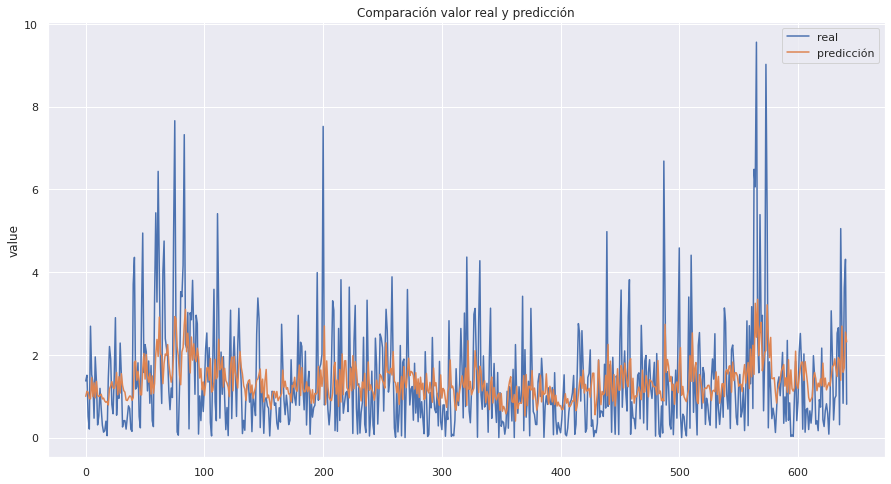

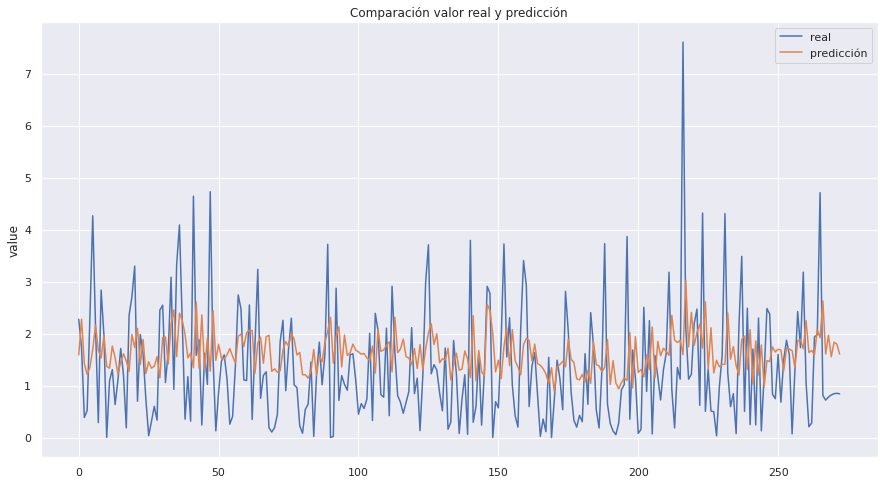

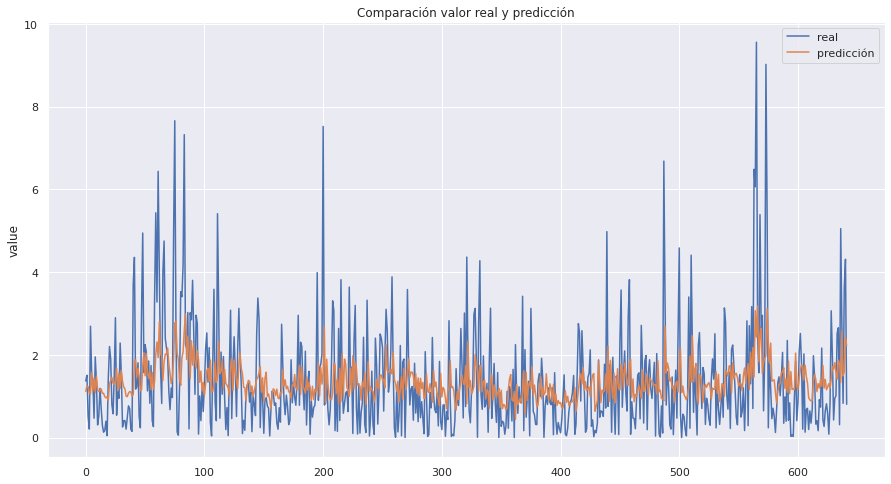

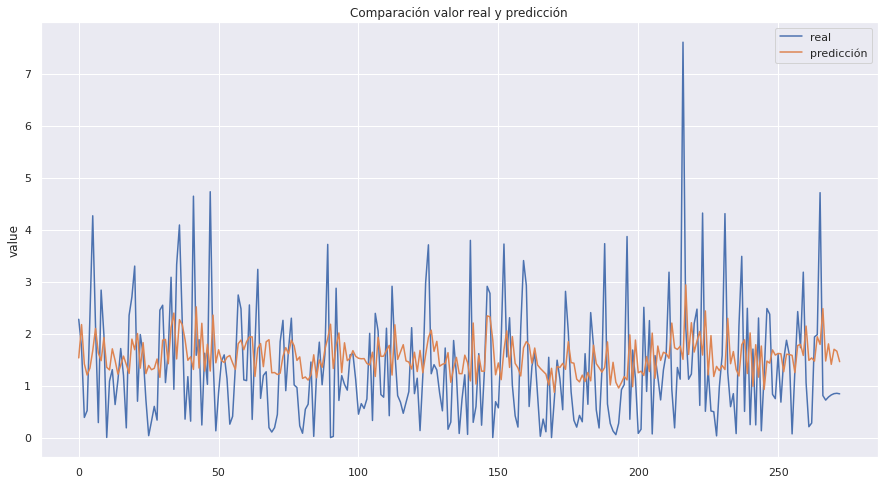

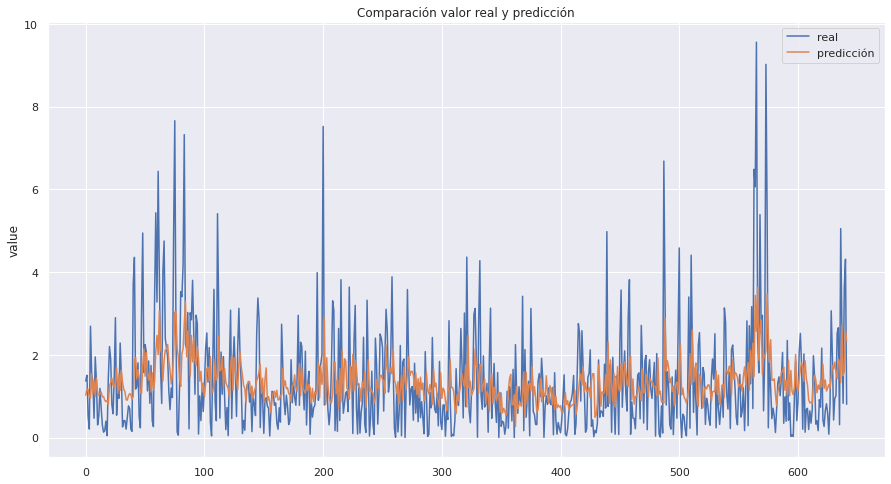

...

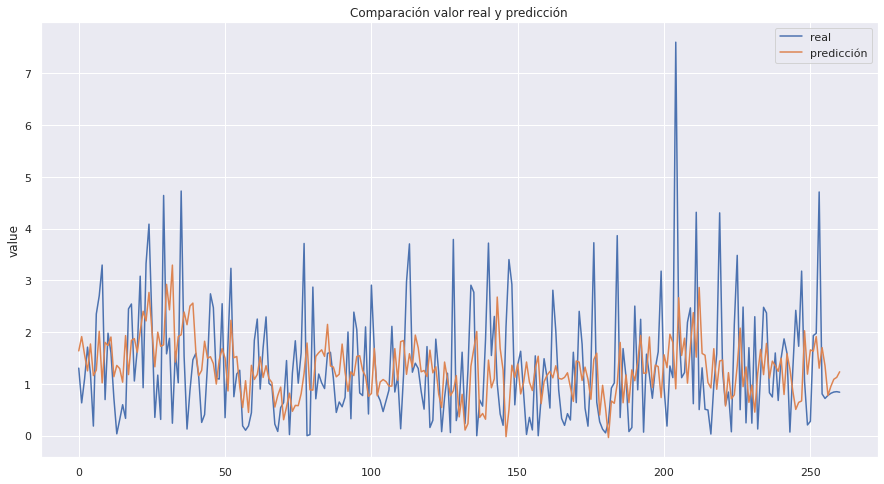

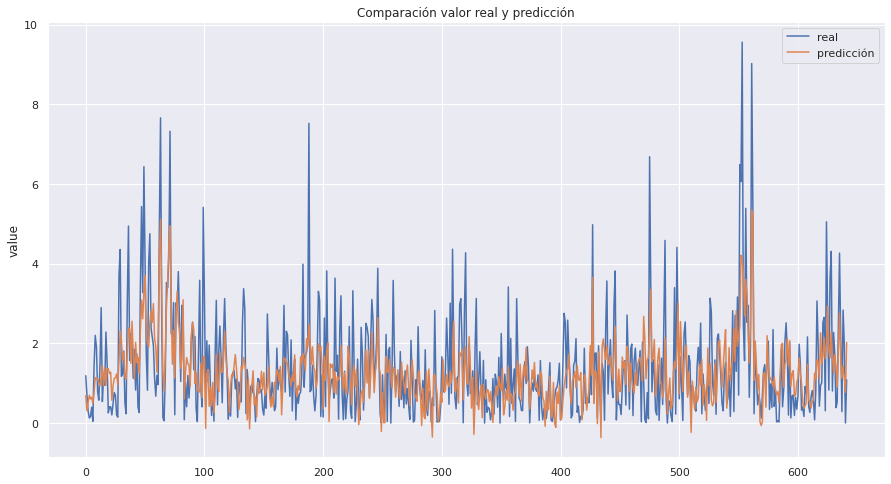

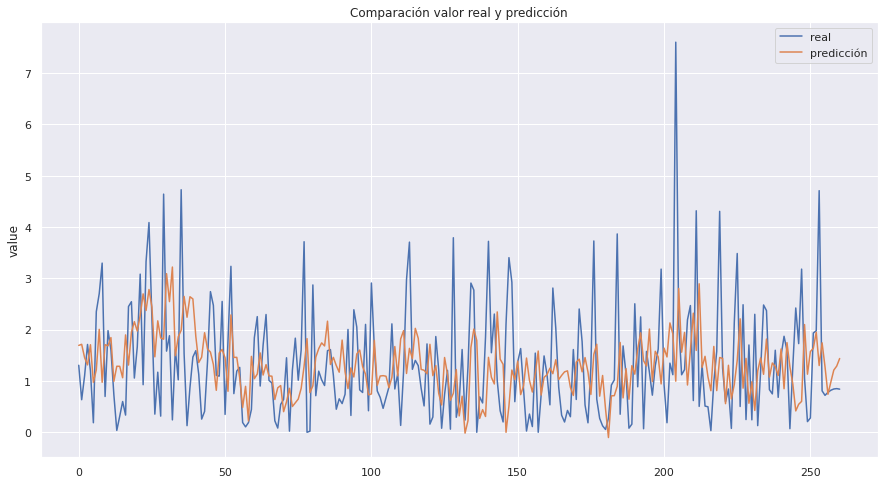

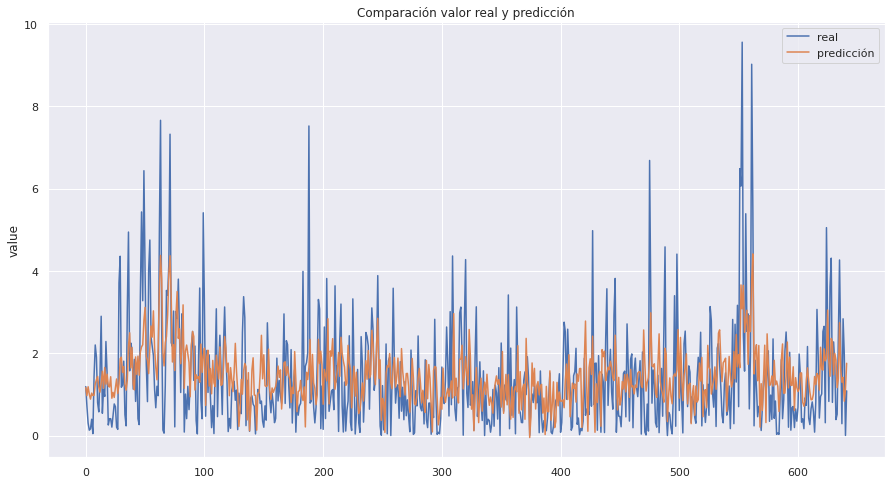

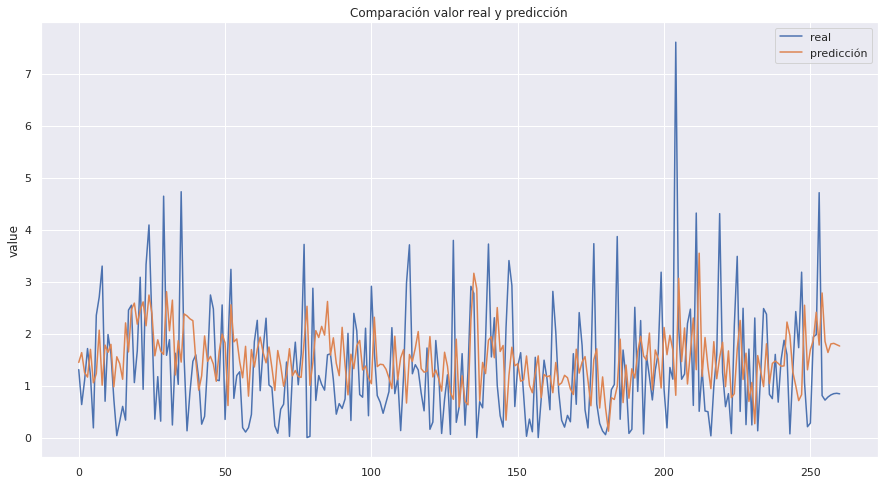

In [11]:
lags=[3,5,7,8,10,15]
n_estimators=[i for i in range(10,100,10)]
n_estimators.extend([200,300,500,2000])
results_models={i:{} for i in lags}
for lg in lags:
    for est in n_estimators:
        results_models[lg][est]=Model(df_data.copy(),df_label.copy(),lg,est)